# 2.2. Properties of signals & systems

<img src="img/cover-2.png"/>

## Contents

* **[Introduction](#intro)**
* **[2.2.1. Signals](#221)**
    * **Example**: [The stock market](#example_stock_market)
    * [The variety of signals](#variety)
    * [Discrete and continuous signals](#discrete_continuous)
    * [Boundedness](#boundedness)
        * **Example**: [Boundedness](#example_boundedness)
    * [Signals as vectors](#signals_vectors)
    * [Discrete impulses](#discrete_impulses)
    * [Continuous impulses](#continuous_impulses)
* **[2.2.2. Systems](#222)**
    * **Example**: [Distortion](#example_distortion)
    * [Causality](#causality)
        * **Example**: [Causal and non-causal smoothing](#example_causal_vs_noncausal)
    * [Invertibility](#invertibility)
        * **Example**: [Invertibility](#example_invertibility)
    * [Stability](#stability)
        * **Example**: [Stability](#example_stability)
    * [Linearity](#linearity)
        * **Example**: [Linear system](#example_linearity)
    * [Translation-invariance](#translation_invariance)
        * **Figure**: [Translation-invariance](#figure_translation_invariance)
        * **Example**: [Non-translation-invariant system](#example_non_ti)
* **[2.2.3. Linear, translation-invariant (LTI) systems](#223)**
    * **Example**: [Convolution](#example_convolution)
    * [LTI systems are convolvers](#lti_action)
        * **Example**: [Convolution reverb](#example_convolution_reverb)
    * [The continuous case](#lti_continuous)
        * **Figure**: [Another interpretation of continuous convolution](#figure_convolution_continuous)
    * [Convolution is commutative](#convolution_commutative)
    * [Convolution is associative](#convolution_associative)
    * [Cascaded systems](#cascaded_systems)
    * [Convolution is distributive](#convolution_distributive)
    * [Parallel systems](#parallel_systems)
    * [The impulse is the convolution identity](#impulse_identity)
    * [Memorylessness](#lti_memoryless)
    * [Invertability](#lti_invertability)
    * [Stability](#lti_stability)
    * [Causality](#lti_causality)
* **[2.2.4. Linear constant-coefficient equations](#224)**
    * **Example**: [Simple and exponential moving average](#example_sma_ema)
    * [Rest initial conditions](#rest_initial)
    * [The general case](#diff_eq_general_case)
        * **Example**: [Intrinsic dynamics](#example_intrinsic_dynamics)

<a id="intro"></a>
***

## Introduction

$\ldots$

<a id="221"></a>
***

## 2.2.1. Signals

A **signal** is a representation of **data**. Specifically, signals attach data to some underlying *space*, and are therefore considered as a **function** from the underlying ambient space to the set where the individual data points themselves "live". In this way signals **attach** data to this underlying space.

When you hear a sound, you are really receiving a signal from the outside world. The data of this signal is *air pressure*: differences in this value are what convey the different varieties of sound to your ear. The underlying space that sound is "attached" to—that the pressure datta is "attached" to—is **time**: the signal associates to every point in time a datum, or pressure value. Hence, we might consider this sound as a function

$$ x: \mathbb{R} \to \mathbb{R}$$

where the first copy of $\mathbb{R}$ represents *time*, where the signal *lives*, and the second copy of $\mathbb{R}$ represents *pressure*, what the signal's *data* points are.

Of course, this is the "ideal" representation of what goes on with sound; it is the realm of the analog, of tape and vinyl. In reality, when sound is **recorded** onto a digital device (like a phone), things look a little different, because digital devices have no way to represent $\mathbb{R}$—the *continuum*. Instead, everything has to get chunked up; *time* is **discretized** into individual units, so that for the digital recording, time looks like $\mathbb{Z}$; and, the data stored by the recorder are **quantized** into units that a computer is able to deal with, again looking like $\mathbb{Z}$; hence, our *recorded* sound is a very different looking signal,

$$ x_\textrm{recorded} : \mathbb{Z} \to \mathbb{Z} $$

<a id="example_stock_market"></a>
***

#### **Example**: The stock market

Stock prices are an excellent and very practical example of a signal. Here's an example taking the last 100 trading days of Microsoft.

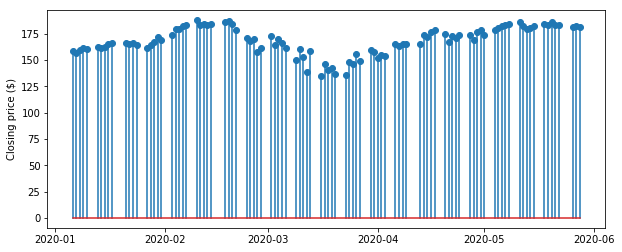

In [65]:
import yfinance
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt

cur_ticker = 'MSFT'
ticker = yfinance.Ticker( cur_ticker )
ticker_history = ticker.history( period = '1y' )

ticker_date = ticker_history.index
ticker_close = ticker_history.loc[:, 'Close']

n_lookback = 100

plt.figure( figsize = (10, 4) )
plt.stem( ticker_date[-n_lookback:], ticker_close[-n_lookback:] )
plt.ylabel( 'Closing price ($)' )
plt.show()

This brings up an interesting point about the representation of signals in some circumstances. Here, we see that the domain of this signal appears to be *dates*; however, because the markets are closed on certain days, this creates a scenario in which the signal is **unevenly sampled**. Although there are techniques to deal with this, one common workaround is to simply ignore the gaps:

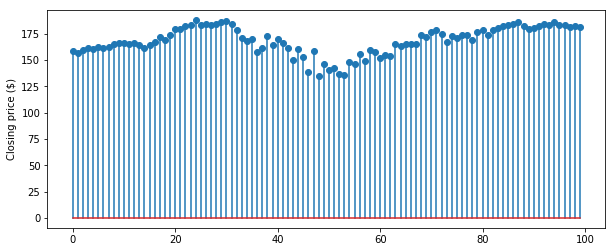

In [66]:
ticker_idx = np.arange( n_lookback )
ticker_close = ticker_history.loc[:, 'Close']

plt.figure( figsize = (10, 4) )
plt.stem( ticker_idx, ticker_close[-100:] )
plt.ylabel( 'Closing price ($)' )
plt.show()

This is now a signal of the form

$$ \mathrm{MSFT}_d : \mathbb{Z} \to \mathbb{R} $$

The domain ($\mathbb{Z}$) is a proxy for where the signal lives—time, where each integer corresponds to a *trading* day. The codomain ($\mathbb{R}$) corresponds to the *data* encoded by this signal, which in this case is *price* (in dollars). (It's notable here that, in reality, price data is *quantized*, because it only goes down to certain fractions of cents. However, we may treat $\mathbb{R}$ as a reasonable substitution, as the values which the price can take are a *subset* of $\mathbb{R}$.)

For fun, we can take this even further and look at **intraday** data:

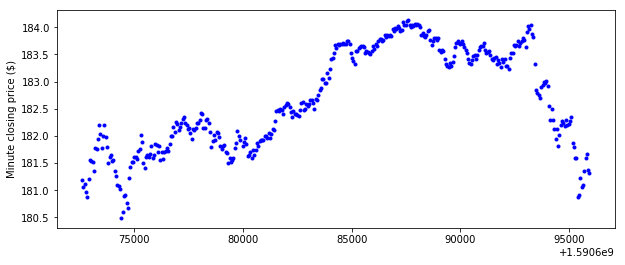

In [67]:
ticker_history_intra = ticker.history( period = '1d', interval = '1m' )

ticker_date_intra = ticker_history_intra.index
ticker_close_intra = ticker_history_intra.loc[:, 'Close']

# Convert index from Yahoo into timestamps for plotting
x_plt = [ x.timestamp() for x in ticker_date_intra ]

plt.figure( figsize = (10, 4) )
plt.plot( x_plt, ticker_close_intra, 'b.' )
plt.ylabel( 'Minute closing price ($)' )
plt.show()

This kind of data will give us a lot of signals to play with for the future!

<a id="variety"></a>
***

### The variety of signals

Signals come in many different shapes and sizes. Importantly, signals are not always associated only with *time*; in fact, **space** plays a very big role in many kinds of signals.

One signal that is ubiquitous in our world is an **image**. An image, after all, is just data—in this case, data about the *brightness* of a portion of 2D space. Because of this, we may treat an "ideal" image as a function

$$ x : \mathbb{R}^2 \to \mathbb{R} $$

Or, recalling that digital devices must discretize space and quantize their data, we may treat a *digital* image as a function

$$ x_{d,q} : \mathbb{Z}^2 \to \mathbb{Z} $$

And of course, we need not stop here! In medical imaging, for example, it is absolutely critical to consider "images" of 3-dimensional space; these are, for example, the familiar outputs of CT or MR imaging. While an idealized physical "image" of someone's head might take the form

$$ x : \mathbb{R}^3 \to \mathbb{R} $$

since these images are captured on computers, once again we need to deal with both discretization of space and quantization of the data:

$$ x_{d,q} : \mathbb{Z}^3 \to \mathbb{Z} $$

And of course, as anyone who has been to the movies can tell you, time and space need not be separate entities in separate signals! An analog film, for example, is a kind of mixed entity, because it has *continuous* spatial dimensions (in analog film, there is no need to chunk up the image into pixels that can be stored on a computer); however, because the film is broken into individual frames, it's temporal dimension is *discrete*. As such, a film as a signal might look something like

$$ x : \mathbb{R^2} \times \mathbb{Z} \to \mathbb{R} $$

By the same token, a *functional MRI*, in which multiple volumetric MR images are taken sequentially over time, might look something like

$$ x : \mathbb{Z^3} \times \mathbb{Z} = \mathbb{Z}^4 \to \mathbb{Z} $$

If we're looking for somethiing even more exotic, we need look no further than our representation of *wind velocity* on the earth. What does such a signal look like? Well, the *data* of this signal is a *vector* pointing in the direction of the wind at a particular point on the earth's surface; and, our domain—where the signal lives—is the surface of the earth, which we can treat as a sphere. Hence, this signal looks like

$$ x : S^2 \to \mathbb{R}^2 $$

***

**This description is probably overkill, skip**

Signals are everywhere, and because they exist at such a high level of abstraction, they are wildly diverse. There are aspects of the theory that transcend many of these superficial differences; however, to develop the theory, we will zoom in to focus on two special cases.

To motivate the first special case, let's bring in a little bit of set theory. There are two fundamental classes of functions between sets that are worth noting. The first type of function is the **surjection**, also called an **onto** function. (I always remember this as the prefix "sur-" has a French root meaning "on".) Surjections "hit" every single element in their codomain; there is no output value that is untouched by the function. Put another way, a surjection $f: X \to Y$ has $\ldots$

The "number of elements" in a set is defined mathematically by using special functions between sets, called **bijections**; a bijection is a function $f: X \to Y$ which pairs up one element of $X$ with *exactly* one element of $Y$. Hence, it is clear why two sets with a bijection between them are the same "size": if you can line up each element of a set with exactly one element of another set, then it follows that there is the same "number" of elements in each set. (The niceness of this definition of size comes from the fact that it works on sets where you can't "count" all the elements, because there are infinitely many of them; in such a case, one may still reasonably construct these bijective *functions* between sets that capture the "essence" of size.)

#### **Definition** (Countable set)
> A set $X$ is said to be **countable** if there is an *injection* $f: X \hookrightarrow \mathbb{N}$.

**This is too much again**

<a id="discrete_continuous"></a>
***

### Discrete and continuous signals

Signals can be broken up into two categories based on their **input** space; as we will see, this difference influences many aspects of the theory. The first category is the most practical of the two, and will be the emphasis in many of the demonstrations in this resource:

#### **Definition** (Discrete signal)
> A signal $x: A \to B$ is called **discrete** if $A$ is *countable*.

Countable sets are those that look like $\mathbb{Z}$: they aren't *thick*, they have no *continuum*. Our prototypical discrete signal will be something of the form

$$ x: \mathbb{Z} \to \mathbb{R} $$

(While above we discussed *quantization* of the data of a signal taking place in digital devices, today most computers use floating-point storage with sufficient precision that many of the negative consequences of this process are mitigated. In reality, computers always represent data in discrete form; however, it is a reasonable and useful approximation to treat this representation as real numbers.)

We sometimes call the individual input values of a discrete signal **samples**; this nomenclature is used because discrete signals are very commonly obtained by taking a continuous process (as we will discuss below) and *sampling* it at discrete points.

The second category of signal describes processes in nature as the *really occur*, despite the fact that our computing machines have no ability to natively represent them. These signals are used to describe the theory of how natural phenomena occur.

#### **Definition** (Continuous signal)
> A signal $x: A \to B$ is called **continuous** if $A$ is *uncountable*.

(It is important to disentangle this poor nomenclature: a *continuous signal*—where the continuous refers to the uncountability of the domain—is very different from a *continuous function*—where the continuous refers to preservation of limits.)

Uncountable sets are those that look like $\mathbb{R}$: they are *thick*, $\ldots$. Our prototypical continuous signal will be something of the form

$$ x: \mathbb{R} \to \mathbb{R} $$

When describing signals, it is helpful to have some notational difference that indicates which class of signals (discrete or continuous) we are working with. Here, we will make the distinction on the basis of what symbol we use for the *input* to the signal; for *discrete* signals, it is traditional to use

$$ x(n) $$

while for *continuous signals*, the more common notation is

$$ x(t) $$

as *time* is quite a common ambient space for continuous signals.

When working with properties that hold for **both** discrete and continuous signals, it is sometomes convenient to talk about both classes at the same time; when we do this, we will talk about signals as being functions 

$$ x: A \to \mathbb{R} $$

where $A$ is a placeholder for either $\mathbb{Z}$ or $\mathbb{R}$; similarly, we will notate the signals' input in this case by

$$ x(a) $$

<a id="boundedness"></a>
***

### Boundedness

When working with signals in any context, one of the critical things we generally would like to avoid is the signal "blowing up"—that is, growing without end. For this reason, it is important to lay down a definition of what "good" behavior looks like. We can do this generally for signals with data in $\mathbb{R}$:

#### **Definition** (Boundedness)
> A signal $x: A \to \mathbb{R}$ is said to be **bounded** if there is a $B \in \mathbb{R}$ such that
>
> $$ |x(a)| \leq B,\quad \forall a \in A$$

That is, $x$ is bounded if $x$ is within some interval $[-B, B]$ for any input value.

<a id="example_boundedness"></a>
***

#### **Example**: Boundedness

A canonical example of a bounded signal is the **unit step** $\theta(a)$, given in either the discrete or continuous case by

$$
\theta(a) =
\left\{
\begin{array}{ll}
      0 & a < 0 \\
      1 & a \geq 0
\end{array} 
\right.
$$

In discrete time, this looks like the following:

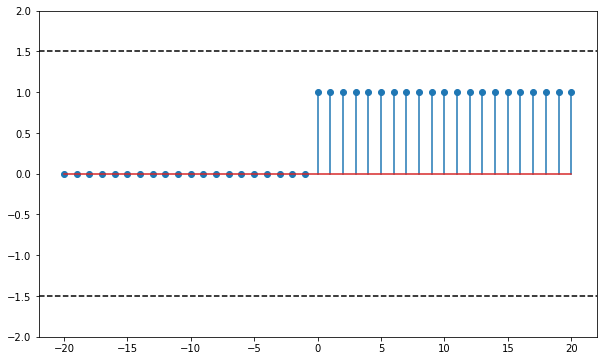

In [95]:
import numpy as np
import matplotlib.pyplot as plt

n_all = np.arange( -20, 21 )
theta = np.zeros( n_all.shape )
theta[n_all >= 0] = 1.

plt.figure( figsize = (10, 6) )

plt.stem( n_all, theta )
xl = plt.xlim()
plt.plot( xl, np.array( [1.5, 1.5] ), 'k--' )
plt.plot( xl, np.array( [-1.5, -1.5] ), 'k--' )
plt.xlim( xl )
plt.ylim( -2., 2. )
plt.show()

The unit step is useful for describing signals with aspects that "turn on" or "turn off" at particular points in the signal's domain. This is an important feature of many practical signals, which often do not stretch infinitely into the past or future!

Notice, as indicated on the plot above, that if we were to draw two lines at $B = 1.5$ and $-B = -1.5$, we would completely enclose the signal for time (imagining that the signal continues in the same way forever in both directions); this shows that $\theta(n)$ (and also $\theta(t)$) is **bounded**.

Let's take a look at another example of a commonly used signal, the **exponential**. For this, we generally use slightly different forms for continuous and discrete time; in discrete time, the base of the exponent is generally used as the parameter $b$:

$$ x(n) = b^n $$

In continuous time, the parameter $\beta$ is generally used in the exponent:

$$ x(t) = \mathrm{e}^{\beta t} $$

$\ldots$ **Pretty pictures** $\ldots$

<a id="signals_vectors"></a>
***

### Signals as vectors

The signals we are working with behave very much like the vectors we discussed in the previous section on linear algebra; in fact, real-valued signals *are* a vector space over the real numbers! To see this, let's define the vector space operations. Let $x, y$ be (continuous or discrete) signals, and $\beta$ be a scalar. Then we define the following operations on signals componentwise:

$$
\begin{eqnarray*}
    (\beta x)(a) = \beta\,(x(a)) & & \textrm{(scalar multiplication)} \\
    (x + y)(a) = x(a) + y(a) & & \textrm{(vector addition)}
\end{eqnarray*}
$$

Because we can perform these operations for any choices of $x, y, \beta$, it follows that the set of signals is a vector space. This additional *algebraic* structure will be crucially important later, as we begin to pose the question of whether there are mappings that *preserve* that strcutrue.

<a id="discrete_impulse"></a>
***

### Discrete impulses

Signals can also be broken down into atomic building blocks, using some intuition from vector spaces. Let's see how this works out with *discrete signals* first.

For this, we'll start off by defining the **unit impulse**:

$$
\delta(n) = 
\left\{
\begin{array}{ll}
      1 & n = 0 \\
      0 & n \neq 0
\end{array} 
\right.
$$

Let's take a look:

<StemContainer object of 3 artists>

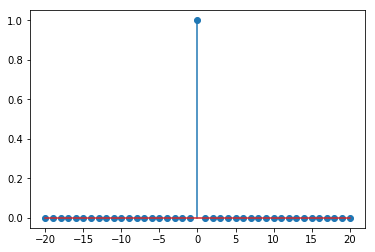

In [44]:
all_n = np.arange( -20, 21 )
delta = np.zeros( all_n.shape )
delta[all_n == 0] = 1.

plt.stem( all_n, delta )

The impulse is important to us because we can use it to build up any other signal by *shifting* and *scaling* it. For example, let's take a look at the signal

$$ x(n) = \frac{1}{2}\,\delta(n+5) + 2\,\delta(n-3) $$

(Recall from above that we can build this function because signals form a vector space! All we're doing is adding and scalar-multiplying signals together.)

Again we can plot this signal:

<StemContainer object of 3 artists>

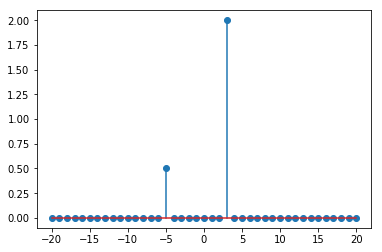

In [45]:
all_n = np.arange( -20, 21 )
x = np.zeros( all_n.shape )
delta_1 = np.zeros( all_n.shape )
delta_2 = np.zeros( all_n.shape )

delta_1[all_n == -5] = 1.
delta_2[all_n == 3] = 1.
x = 0.5 * delta_1 + 2 * delta_2

plt.stem( all_n, x )

So we see that $\delta(n-k)$ *shifts* the impulse by $k$ samples. This makes sense: after all, we know that $\delta(n) = 1$ when $n = 0$; thus, it must be that $\delta(n-k) = 1$ when $n-k = 0$—that is, when $n = k$. So we see that we can build up more complicated signals from impulses.

However, the great trick is that we can use these impulses to build *any* signal! Let's consider a discrete signal $x(n) = \cos(n/4)$; plotted out, this looks like the following:

<StemContainer object of 3 artists>

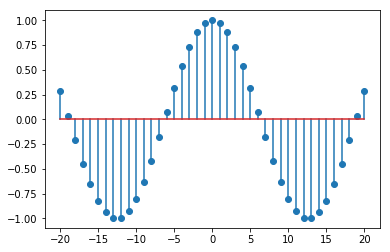

In [48]:
all_n = np.arange( -20, 21 )
x = np.cos( (1./4) * all_n )

plt.stem( all_n, x )

Notice that *each* time point of this signal is really just a scaled and shifted impulse! If we explicitly wrote this out, we would have something like

$$ x(n) = \ldots + x_{-2} \delta(n+2) + x_{-1} \delta(n+1) + x_{0} \delta(n) + x_{1} \delta(n-1) + x_{2} \delta(n-2) + \ldots $$

where the scale factors $x_n = x(n)$ are determined by the original signal. Here each term in the sum corresponds to the addition of one scaled and shifted impulse—one "stem" in the plot. Now, we can generalize this sum to something a little more compact:

$$ x(n) = \sum_{i=-\infty}^\infty x_i\, \delta(n-i) = \sum_{i=-\infty}^\infty x(i)\, \delta(n-i) $$

where we note that the scale factors for the individual impulses are, in fact, the signal evaluated at the index of summation. It is *this* representation that we will come back to; indeed, every signal can  be broken down into this form, where its atoms are laid bare.

<a id="continuous_impulses"></a>
***

### Continuous impulses

For continuous signals, the situation is a bit more complicated. Just as in the discrete case, however, we once again have an atom—denoted $\delta(t)$—which we will see allows us to build up any signal.

To motivate this derivation, consider the function

$$
f_1(t) = 
\left\{
\begin{array}{ll}
      1 & t \geq -\frac{1}{2}\textrm{ or }t \leq \frac{1}{2} \\
      0 & \textrm{otherwise}
\end{array} 
\right.
$$

This function—a square centered at 0—has an integral of $1$, and a width of $1$. However, we can iteratively make it thinner and thinner by defining the sequence of functions

$$
f_k(t) = 
\left\{
\begin{array}{ll}
      k & t \geq -\frac{1}{2k}\textrm{ or }t \leq \frac{1}{2k} \\
      0 & \textrm{otherwise}
\end{array} 
\right.
$$

We can visualize an approximation of this sequence below:

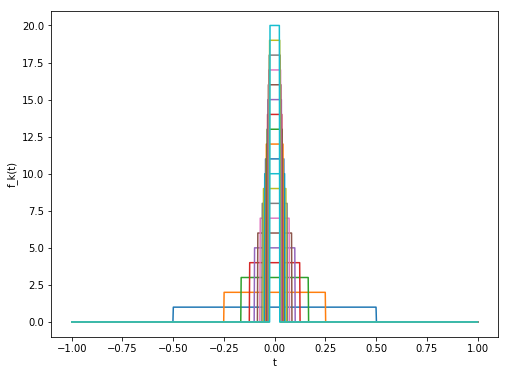

In [100]:
import numpy as np
import matplotlib.pyplot as plt

t = np.linspace( -1, 1, 1000 )

plt.figure( figsize = (8, 6) )

for k in range( 1, 21 ):
    fk = np.zeros( t.shape )
    fk[np.logical_and( t >= -1./(2*k), t <= 1./(2*k) )] = k
    plt.plot( t, fk )

plt.xlabel( 't' )
plt.ylabel( 'f_k(t)' )
plt.show()

Notice that, once again, the integral of all these functions is $1$, despite the fact that as $k$ increases, the rectangles defined by $f_k$ get thinner and thinner, taller and taller. Eventually, if we were to take

$$ \delta = \lim_{k\to\infty} f_k $$

we would have a function that is infinitely thin, infinitely tall, and—very importantly—still has an integral of $1$. This is precisely our "atom" for the continuous case: the **Dirac delta** $\delta(t)$.

(Notice that, as its value at $t=0$ is infinite, $\delta$ is not, strictly speaking, a *function*; however, it "exists" in enough of a sense to be extremely useful for computations! The rigorous foundations for the use of $\delta$ can be found in the theory of "[distributions](https://en.wikipedia.org/wiki/Distribution_(mathematics)#Basic_idea)".)

(Note also from this definition that the Dirac delta is **symmetric**! That is, $\delta(t) = \delta(-t)$.)

The Dirac delta also has another important property with regard to integration: not only is its integral $1$, but it is able to *select* values, by virtue of the fact that it is only nonzero at a single point. For example, if we have a given function $f(t)$, then

$$ \int_{-\infty}^\infty f(t) \delta(t - T)\,\mathrm{d}t = f(T) $$

This occurs because $\delta(t-T)$ is nonzero precisely at $T$; hence, there is only this one value available for integration over.

In a very analogous way to our derivation for discrete signals, we can rearrange this property to yield a decomposition of a continuous signal into a "sum" of shifted atoms; however, in the continuous case, this sum is replaced by an *integral*:

$$ x(t) = \int_{-\infty}^\infty x(\tau) \delta(t - \tau)\,\mathrm{d}\tau $$

Once again, we note that any signal can be decomposed into a sum of scaled and shifted impulses—this time, infinitessimally thin!

<a id="222"></a>
***

## 2.2.2. Systems

When you play a record on a turntable, there are a number of steps that take place before the sound reaches your ears. The *stored* signal is in the grooves of the record itself; for a monophonic record, this is represented by the *depth of the groove* at any given point along the record's spiral. This spiral—the substrate on which the record's data is encoded—is really just a curled up version of the real line, $\mathbb{R}$; hence, we can treat this signal (with the groove as the substrate and the groove height as encoding the data) as a **continuous** signal:

$$ x_\mathrm{record} : \mathbb{R} \to \mathbb{R} $$

Now, for this signal to reach our ears, it has to first get transformed into a form that the record player can handle. The record player, like most electronic circuits, encodes data as *voltage* on a substrate of *time*. The critical **transducer** between these two representations of the record's data—the physical height of grooves to the voltage fluctuations in the turntable's circuits—is the *cartridge*, the portion of the turntable that contains the needle. When the needle vibrates up and down in the groove, a magnet moves through wire coils in the cartridge; the movement of the magnet through these coils induces currents within the wires, which results in the turntable's representatioin as voltage:

$$ x_\mathrm{turntable} : \mathbb{R} \to \mathbb{R} $$

What is critical here is the action of the transducer *itself*: it has transformed one signal, $x_\mathrm{record}$, into another signal, $x_\mathrm{turntable}$. The transducer is completely indifferent as to what the particular record is played; any input signal $x$ could have ben put into the system (conceptualized here as playing a different record), and the resulting *output* of the transducer would be the corresponding representation of that record within the circuitry of the record player. The transducer defines a *input-output* mapping between our example signals:

$$ T : x_\mathrm{record} \mapsto x_\mathrm{turntable} $$

However, if we denote the set of all continuous signals as $S_c$, then we can think of this transducer more generally as a *function* from signals to signals:

$$ T : S_c \to S_c $$

Transformations of this type—which turn one signal into another signal—are known as **systems**. Systems are ubiquitous throughout every disciplines, as we will see shortly; and while often our goal is to *study* the characteristics of a given system, we also have tools that enable us to *design* systems to fulfill certain desired tasks. Systems are descriptions of processes in nature that change data from one form to another, as well as tools that allow us to change data we observe into a form that has properties beneficial to our purposes.

<a id="example_distortion"></a>
***

#### **Example**: Distortion

Let's look at an example of another system in the domain of audio. There are many examples of systems to be found in audio signal processing, but the one we'll look at here has a special property worth investigating!

First of all, let's take a look at our input *discrete* signal $x(n)$, which we'll load in from an audio file (hence why the signal is discrete). We'll start off by taking a look at the *waveform* of the signal $x(n)$, the actual raw values of its data as a function of $n$:

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/librosa/core/audio.py:161: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn('PySoundFile failed. Trying audioread instead.')


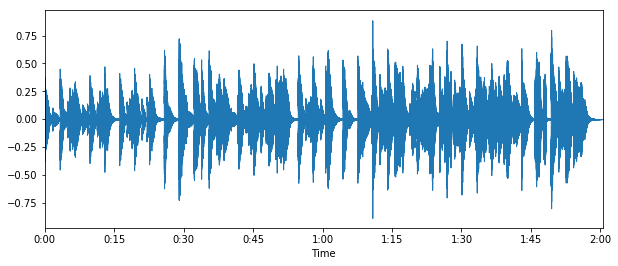

In [16]:
import librosa
import librosa.display
import IPython.display as ipd

import matplotlib.pyplot as plt

# Load the signal from disk
# x is the audio signal
# Fs is the sampling rate of the audio
x, Fs = librosa.load( 'data/grave.mp3', sr = None )

# Plot the signal
plt.figure( figsize = (10, 4) )
librosa.display.waveplot( x, sr = Fs )
plt.show()

We can even use this loaded-in data to listen to the signal!

In [18]:
# Play the signal as audio
ipd.Audio( x, rate = Fs )

Our system is going to be defined by a transformation that takes place *at each sample* $n$ of $x$. That is, we are going to define a function $f: \mathbb{R} \to \mathbb{R}$, which takes an input sample and transforms it into an output sample; then, to form our output *signal* $y(n)$, we iterate this process for every sample:

$$ y(n) = f(x(n)), \quad \forall n \in \mathbb{Z} $$

Noticie first of all that if we made $f$ the straight line $f(r) = r$, that we would end up with

$$ y(n) = f(x(n)) = x(n) $$

The result would be the **identity system**, which simply spits out whatever is put in unchanged. However, we can make $f$ a little more interesting by deviating from this straight line prototype. For example, one interesting choice of $f$ is the centered *sigmoid function*:

$$ f(r) = \frac{2}{1 + \mathrm{e}^{-k r}} - 1 $$

This function is shown plotted below. As shown, this function displays two characteristics that make it interesting from the point of view of the output signals we might obtain from it. First of all, it *clamps* large values of the input to the maximum or minimum allowed value, which in this parameterization turns out to be $\pm 1$. Second of all, it *amplifies* small values of the input; this is evident in the region of the sigmoid near the center that is still mostly linear, but with a slope larger than $1$. The combination of these two properties means that this system **compresses the dynamic range** of the input audio: it makes soft sounds louder, and it makes loud sounds softer.

(In practice, as you might have seen from the plot of $x(n)$ above, this function will not have much of the latter effect, because the maximum amplitude of $x$ is below the point where clamping takes place.)

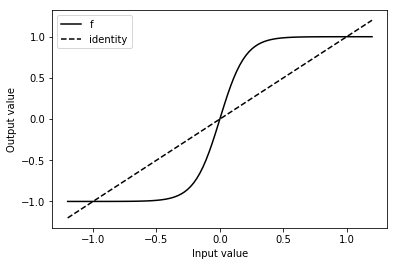

In [30]:
import numpy as np
k = 10.0
f = lambda r: (2 / (1 + np.exp(-k * r))) - 1

r_plot = np.linspace( -1.2, 1.2, 100 )
plt.plot( r_plot, f( r_plot ), 'k-', label = 'f' )
plt.plot( r_plot, r_plot, 'k--', label = 'identity' )
plt.xlabel( 'Input value' )
plt.ylabel( 'Output value' )
plt.legend()
plt.show()

This system is also special because it is **memoryless**: as we alluded to when we defined the sample-wise transformation $f$, the *system*, which transforms *entire signals*:

$$ T: x \mapsto y $$

is remarkable in that every sample $y(n)$ of the output is determined *only* by a function of its corresponding input sample $x(n)$, for every $n$. For systems in general, this need not be the case; as we will see shortly, there are a wealth of systems that involve the *history* of $x$ at prior samples—and even, sometimes, the *future* of $x$—in order to determine the value of $y$ at the current sample $n$. However, any system $T$ that is determined sample-wise—like our current system—is said to be memoryless

Now, let's take a look at how our current memoryless system affects our input.

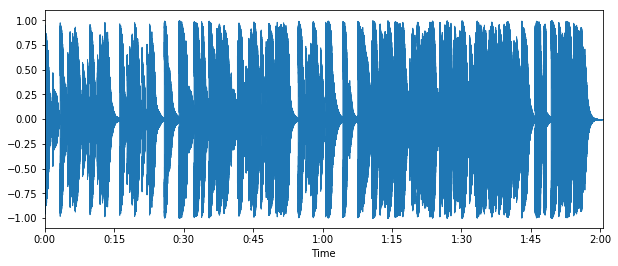

In [31]:
import numpy as np

# Perform the transformation sample-wise
y = f( x )

# Plot the signal
plt.figure( figsize = (10, 4) )
librosa.display.waveplot( y, sr = Fs )
plt.show()

In [24]:
# Play the output signal as audio
ipd.Audio( y, rate = Fs )

What observations do you make when listening to this transformed output? It is clearly louder; however, at the same times, there are moments where the sound is "crunchy" somehow, where there appears to be a real change in the quality of the output. This phenomenon is called **distortion**, and as we will see in the next chapter, it arises when systems posess certain properties, and can be mitigated by sticking to certain design principles when constructing a system.

<a id="causality"></a>
***

### Causality

Memoryless systems like the one above are an extreme example of the different kinds of dependencies on the underlying space that a system can have: in this case, the dependency was constrained to be located at a single point.

For real-world systems, one of the most common constraints that we enocunter is **causality**. Generally, physical processes are assumed to be *causal*, relativistic concerns notwithstanding: that is, the current state of a process in the *present* is thought of as a result of the state of that process in the *past*. If what I end up eating for lunch tomorrow somehow was able to influence what I am writing presently, we would live in a very different world than what we seem to live in according to physical observation. Thus, our intuitive definition oif causality is this: a system is **causal** if its output at the *present* depends only on its input in the *past* or *present*. (Hence, memoryless systems are a subset of causal systems.)

Formally, we define this in a somewhat counterintuitive way for both discrete and continuous systems:

#### **Definition**: Causality
> A system $T$ is causal if, given any two inputs $x_1$ and $x_2$ and some time/sample $a_0$, then
>
>$$ x_1(a) = x_2(a)\quad\forall a < a_0 $$
>
> implies that, for the respective outputs of the system $y_1$ and $y_2$,
>
>$$ y_1(a) = y_2(a)\quad\forall a < a_0 $$

What this is saying is really just a rearrangement of what our intuition was above: if two signals have the *same past*, as we ensure with the first condition, then a causal system must produce the *same output*. Although the two inputs and outputs might diverge *after* $a_0$, where they are no longer guaranteed to have the same history, causality implies that, because there is a region where the two signals have an identical past, the system must produce identical outputs, because there is nothing else the system can depend on!

<a id="example_causal_vs_noncausal"></a>
***

#### **Example**: Causal and non-causal smoothing

Let's look at an example of what happens when we design systems to be either causal or non-causal. In this case, we are going to be dealing with the discrete **moving average** system, which we will apply to the stock data we pulled up earlier. First, let's define what we mean by a moving average. The **causal** moving average system with $N$ points is defined by

$$ T_\mathrm{causal}: x(n) \mapsto y(n) = \frac{1}{N} \sum_{i=0}^{N-1} x(n-i) $$

Here we are averaging all ofo the samples from $N-1$ in the past all the way up to the present value—but, we take care not to include any samples from the future! Let's see how this plays out with real data:

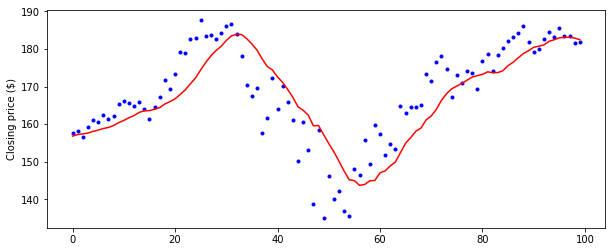

In [42]:
import yfinance
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt

cur_ticker = 'MSFT'

msft = yfinance.Ticker( cur_ticker )
msft_history = msft.history( period = '1y' )

msft_date = msft_history.index
msft_close = msft_history.loc[:, 'Close']

# Compute the moving average
ma_N = 11
msft_close_smooth = np.zeros( msft_close.shape )
for n in range( msft_close.shape[0] ):
    cur_sum = 0.
    for i in range( 0, ma_N ):
        cur_idx = n - i
        if cur_idx < 0:
            # We assume that anything we don't have a data point for is a zero
            # That is, our signal is assumed to be *zero-padded*
            cur_input = 0.
        else:
            cur_input = msft_close[cur_idx]
        cur_sum += cur_input
    msft_close_smooth[n] = (1. / ma_N) * cur_sum

n_lookback = 100
msft_idx = np.arange( n_lookback )

plt.figure( figsize = (10, 4) )
plt.plot( msft_idx, msft_close[-n_lookback:], 'b.' )
plt.plot( msft_idx, msft_close_smooth[-n_lookback:], 'r.' )
plt.ylabel( 'Closing price ($)' )
plt.show()

Note that this is a *causal* system: the most recent value used in the average is the *present*, and hence no data are used from the future. Looking at the plot is interesting though: it seems as though the average trace (in red) is shifted to the *right*; that is, movements in the average trace tend to happen *after* movements in the actual data. This is the price we pay for causality: because the vast majority of the information our moving average system is from the past, our system's "view" of the world is shaped almost entirely by the past. And hence, our output **lags** the true output.

We can modify the causal moving average slightly to generate a **noncausal moving average**. The noncausal moving average with (odd) $N=2K+1$ points is given by

$$ T_\mathrm{noncausal}: x(n) \mapsto y(n) = \frac{1}{2K+1} \sum_{i=-K}^{K} x(n-i) $$

Here we are averaging over a symmetrical window, from $K$ samples in the past to $K$ samples in the future. Notice from this expression that we are explicitly including knowledge about the *future* into our output $y(n)$ (namely, when the index $i$ of the sum is negative)!

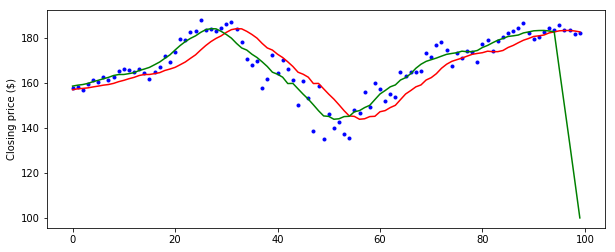

In [43]:
cur_ticker = 'MSFT'

msft = yfinance.Ticker( cur_ticker )
msft_history = msft.history( period = '1y' )

msft_date = msft_history.index
msft_close = msft_history.loc[:, 'Close']

# Compute the moving average
ma_K = 5
msft_close_smooth_nc = np.zeros( msft_close.shape )
for n in range( msft_close.shape[0] ):
    cur_sum = 0.
    for i in range( -ma_K, ma_K + 1 ):
        cur_idx = n - i
        if cur_idx < 0 or cur_idx >= msft_close.shape[0]:
            # We assume that anything we don't have a data point for is a zero
            # That is, our signal is assumed to be *zero-padded*
            cur_input = 0.
        else:
            cur_input = msft_close[cur_idx]
        cur_sum += cur_input
    msft_close_smooth_nc[n] = (1. / ma_N) * cur_sum

n_lookback = 100
msft_idx = np.arange( n_lookback )

plt.figure( figsize = (10, 4) )
plt.plot( msft_idx, msft_close[-n_lookback:], 'b.' )
plt.plot( msft_idx, msft_close_smooth[-n_lookback:], 'r.' )
plt.plot( msft_idx, msft_close_smooth_nc[-n_lookback:], 'g.' )
plt.ylabel( 'Closing price ($)' )
plt.show()

Note that the new noncausal trace (green) matches the data much more closely. However, note also that one sacrifice we make for this is that we cannot use this system close to the present without adding some additional assumptions, as we don't know the future! Because in this instance we assume the data are zero-padded, the non-causal estimiator falls off toward zero as it reaches the present because there are no more additional data points in the future to use.

<a id="invertibility"></a>
***

### Invertibility

One critical question we might ask about a system is whether we can *get back* what we put into it somehow; that is, is there some way for us to create a new system that *inverts* the system we're investigating?

#### **Definition**: Invertibility
> A system $T$ is **invertible** if there exists another system $T'$ such that, for any input signal $x$,
>
> $$ T'(T(x)) = x $$
> 
> If such a system exists, we call iti the **inverse** of $T$, and denote it by $T^{-1}$.

Intuitively, invertibility of $T$ means that $T$ is a *one-to-one correspondence* between input and output signals; that is, every output signal can be obtained by some input signal, and no two input signals go to the same output signal. If there were signals that couldn't be obtained as outputs, then there would be no way to define the inverse system for all signals—there would be nowhere to "send" the unobtainable outputs. Similarly, if there were two signals that were mapped to the same output by $T$, then the inverse system would have to make a choice about which of those two signals to send that output to—again, there would be no way to define the inverse system consistently.

<a id="example_invertibility"></a>
***

#### **Example**: Invertibility

Consider the discrete system defined by

$$ y(n) = x(2n) $$

First of all, let's get an intuitive sense of what this system does: it takes *every other sample* from $x$ and plops it into the output. So, it would seem that this system is somehow **lossy**: that is, inforomation about $x$ (namely every other sample!) goes away in the transformation from $x$ to $y$. Can we explicitly construct two signals that both get mapped to the same output?

Take, for example,

$$
\begin{eqnarray*}
    x_1(n) & = & \delta(n) \\
    x_2(n) & = & \delta(n) + \delta(n - 3)
\end{eqnarray*}
$$

Note that both signals are the same *except* for one impulse on a *odd sample*. This sample is completely skipped over in the definition of our system; hence, both signals end up getting mapped to the output

$$ y(n) = \delta(n) $$

Hence, this system is not invertible.

As a contrast, let's consider the following system:

$$
y(n) = 
\left\{
\begin{array}{ll}
      x(n-1) & n > 0 \\
      0 & n = 0 \\
      x(n) & n < 0
\end{array} 
\right.
$$

Intuitively, this system takes the input signal and breaks it into two pieces at sample $0$; then, it shifts the rightward part of the signal over by one sampmle, and inserts a $0$ at $n= 0$. So we see that, fundamentally, all the data of $x$ is *there*; it's just been shifted around, in a non-destructive way. Indeed, the inverse to this system can be explicitly found as the following:

$$
x(n) = 
\left\{
\begin{array}{ll}
      y(n+1) & n \geq 0 \\
      y(n) & n < 0
\end{array} 
\right.
$$

<a id="stability"></a>
***

### Stability

Above we defined the notion of *boundedness* for signals, which intuitively asks whether the signal "blows up" in any direction. One very practical question we are often interested in for a given system is whether that system takes input signals that *don't* blow up (*i.e.*, are bounded) and spits out output signals that *do* blow up (*i.e.*, are not bounded). Systems that do this are considered **unstable** in a sense, because they are liable to take "nicely" behaving inputs and mess them up. It is convenient to define the opposite notion of **stability** as well:

#### **Definition**: BIBO stability
> A system $T$ is **bounded-input bounded-output stable** if, for any signal $x$,
>
> $$ x\textrm{ is bounded} \Rightarrow T(x)\textrm{ is bounded} $$

<a id="example_stability"></a>
***

#### **Example**: Stability

Consider the discrete system $T_1: x \mapsto y$ defined by

$$ y(n) = \alpha\,x(n) $$

for some $\alpha > 0$. Let's see if $T$ takes *bounded inputs* to *bounded outputs*. Suppose that $x$ is bounded; that is, by definition, there is a number $B > 0$ such that $|x(n)| \leq B$ always. Then, it follows that

$$ |y(n)| = |\alpha\,x(n)| \leq \alpha B $$

for all $n$. So it appears our system $T_1$ is in fact BIBO stable!

Now, let's think about another commonly used system: the **accumulator**. This is a discrete system $T_2: x \mapsto y$ defined by

$$ y(n) = \sum_{i=-\infty}^n x(i) $$

This system *adds up* (or "accumulates") the successive values of $x$ as samples progress. Is this system BIBO stable? We can think about this question in terms of an example bounded signal that we saw above: the unit step, $\theta(n)$. If we plug this function in as input, then we find that the accumulated output is equal to

$$
\begin{eqnarray*}
    y(n) & = & \sum_{i=-\infty}^n \theta(i) \\
     & = & \sum_{i=0}^n 1\quad\textrm{(*)} \\
     & = & \left\{\begin{array}{ll}
             0, & n < 0 \\
             n + 1, & n \geq 0
           \end{array}\right.
\end{eqnarray*}
$$

where (\*) follows from the fact that $\theta(n)$ is zero at all samples before $n = 0$. This is clearly not a bounded output: as $n$ increases without bound, so does $y(n)$! As we have shown that the accumulator $T_2$ takes a bounded input $\theta(n)$ to an unbounded input, it is apparent that this system is **not** BIBO stable.

<a id="linearity"></a>
***

### Linearity

We now come to two properties of systems that lie at the heart of our later analyses. The first actually comes from our earlier observation that signals form a vector space. Let's motivate it with some intuition. Earlier we discussed a record player in the context of systems: indeed, the physical movement of the needle in the groove must be translated into voltage in the circuits of the turntable, and even further, this voltage in the turntable must eventually be transformed via the transducers in speakers to pressure waves in the air. Say you're designing a record, and you'd like to make it so that there are two sounds playing at once: drums and bass. How do you make it so that the listener hears both sounds at the same time—that is, so that both sounds **superpose**? The answer is that you **add** the groove fluctuations of both sounds *together* and press their *sum*: when these summed grooves are transduced by the cartridge apparatus, the ensuing voltage generated in the turntable's circuits will be precisely the sum of the voltages that would have been generated by the individual instruments' grooves on their own.

(Of course, it's worth pointing out that this principle has limits. For example, the fluctuations in the record can become so large that they actually dislodge the needle entirely, a phenomenon that infamously plagued early 20th century recordings of Gustav Holst's *First Suite for Military Band*, because of an extremely loud bass drum hit in the final movement. In real-world systems, many properties hold only approximately, and within particular ranges of operation.)

This observation arises precisely because of the **linearity** (or at least approximate linearity) that takes place in these systems. And, as we saw earlier, linearity is really a manifestation of *structure-preservation*. The structure-preserving maps between vector spaces were precisely the **linear operators**. What are the linear operators between the vector spaces of signals? They are precisely the **linear systems**!

A linear system is a system that preserves the vector space structure of the underlying input signals; that is, for given signals $x_1,x_2$ and real number $\alpha$, a linear system must satisfy

$$
\begin{eqnarray*}
    T(\alpha x_1) = \alpha T(x_1) & \, & \textrm{(scalar multiplication)} \\
    T(x_1 + x_2) = T(x_1) + T(x_2) & \, & \textrm{(vector addition)}
\end{eqnarray*}
$$

Now, recall that any discrete signal $x(n)$ can be broken down into a sum of scaled and shifted impulses:

$$ x(n) = \sum_{i = -\infty}^\infty x(i) \delta(n - i) $$

Equipped with the laws just laid down above, we now can see exactly what happens when this signal passes through a linear system $T: x \mapsto y$:

$$ y(n) = T\left( \sum_{i = -\infty}^\infty x(i) \delta(n - i) \right) $$

First we note that we can pull out the sum:

$$ y(n) = \sum_{i=-\infty}^\infty T( x(i) \delta(n-i) ) $$

Now we can pull out the scalars $x(i)$; recall that, since these quantities don't depend on $n$, we can treat them as scalars, rather than vectors; here, $n$ indexes the actual underlying space of the signal! This gives us our result:

$$ y(n) = \sum_{i=-\infty}^\infty x(i)\, T(\delta(n-i)) $$

So we see that linear systems are *completely determined* by their behavior on *shifted impulses*! Let's have $h_i(n) = T(\delta(n-i))$ denote the response of the system $T$ to an impulse shifted by $i$; this family of functions is known as the set of **Green's functions** for $T$. We can simplify further, then, and write $y$ in terms of these functions:

$$ y(n) = \sum_{i=-\infty}^\infty x(i)\, h_i(n) $$

So a linear operator defines a particular response signal $h_i(n)$ to a unit impulse $\delta(n-i)$; these responses then completely define the system's outputs!

We can do a similar derivation based on the decomposition of *continuous* signals:

$$ x(t) = \int_{-\infty}^\infty x(\tau) \delta(t - \tau)\,\mathrm{d}\tau $$

Now, let's pass this signal through a linear system $T: x \mapsto y$:

$$ y(t) = T\left( \int_{-\infty}^\infty x(\tau) \delta(t - \tau)\,\mathrm{d}\tau \right) $$

Acknowledging that interchanging integration is a bit of a sticky mathematical problem, let's suppose that the linearity of $T$ does enable us to treat the integral like we treated the sum:

$$ y(t) = \int_{-\infty}^\infty T(x(\tau) \delta(t - \tau))\,\mathrm{d}\tau $$

Now once again we can pull out the scalar $x(\tau)$ from the system:

$$ y(t) = \int_{-\infty}^\infty x(\tau) T(\delta(t - \tau))\,\mathrm{d}\tau $$

Once again we see that the linear system is completely determined by its responses on shifted impulses. Defining these responses (the *Green's functions*) again by $h_\tau(t) = T(\delta(t-\tau))$, we finally have

$$ y(t) = \int_{-\infty}^\infty x(\tau) h_\tau(t)\,\mathrm{d}\tau $$

So we see that, in either case, the *linearity* of a system dramatically constrains that system's behavior; linearity of a system $T$ implies that, instead of having any possible behavior, $T$'s outputs are determined **entirely**  from $T$'s behavior on shifted unit impulses.

<a id="example_linearity"></a>
***

#### **Example**: Linear system

Consider the continuous system $T$ defined by

$$ y(t) = \cos(t)\,x(t) $$

Is this linear? The fastest way to check is to look for both scalar multiplication and vector addition in one swoop. Take two signals $x_1, x_2$ and two scalars $\alpha_1, \alpha_2$. Then, letting $x(t) = \alpha_1 x_1(t) + \alpha_2 x_2(t)$, we can compute $T(x) = y$ as:

$$
\begin{eqnarray*}
    y(t) & = & \cos(t)\,(\alpha_1 x_1(t) + \alpha_2 x_2(t)) \\
     & = & \alpha_1(\cos(t) x_1(t)) + \alpha_2(\cos(t) x_2(t)) \\
     & = & \alpha_1 y_1(t) + \alpha_2 y_2(t)
\end{eqnarray*}
$$

where $y_1 = T(x_1)$ and $y_2 = T(x_2)$. Hence, $T$ is linear.

Note that the Green's functions for this system can be determined by

$$ h_\tau(t) = \cos(t)\,\delta(t-\tau) $$

Hence, when intnegrating to find the solution for a given $x$ (although not necessary here, since we are given an explicit formula), we find that

$$
\begin{eqnarray*}
    y(t) & = & \int_{-\infty}^\infty x(\tau)\,h_\tau(t)\,\mathrm{d}\tau \\
     & = & \int_{-\infty}^\infty x(\tau)\,\cos(t)\,\delta(t-\tau)\,\mathrm{d}\tau \\
     & = & \cos(t)\,\int_{-\infty}^\infty x(\tau) \delta(\tau-t)\,\mathrm{d}\tau \\
     & = & \cos(t)\,x(t)
\end{eqnarray*}
$$

which is precisely our definition for $T$!

<a id="translation_invariance"></a>
***

### Translation-invariance

When you put a record on your turntable, start the record turning, and set the needle, sound comes out. You start playing the record at a certain point in time $t_0$, and immediately thereafter sound comes out (at the very least a few seconds of scratch, before the main body of the record starts). So you gave the turntable an input—the record groove that you placed on the platter—and the turntable produced an output of sound.

So what happens if you waited a year and tried the same thing? The turntable's still the same, the record's still the same—everything is still the same; the only difference is that a year has passed, so that now you are providing your input to the turntable at $t_0 + 1\textrm{ year}$. What is the result? With all the components still the same, the expectation is that the sound that comes out of the system will be the same too—almost. Critically, the sound will be **translated** in time by a year—after all, you are playing the record a year later, so it makes sense for the output of the turntable system to *occur* a year later. We will see that this property—translating the input results in translating the output—has major implications for our systems under study!

(As with linearity above, we note that this observation has limits: 5000 years into the future, the turntable is unlikely to function as it does in the present. Hence, we see that many properties of real-world systems hold either only approximately, or only within certain ideal operational ranges of their inputs.)

To formalize this notion, let's introduce the **delay** system, which works in either the continuous or discrete case:

$$ D_\alpha : x(a) \mapsto x(a - \alpha) $$

(As an interesting aside, the delay systems are fascinating entities because they link together the behavior of the *substrate* space of signals—the domain of signals, the space where the data are attached to—to the linear algebra of systems: notice how the arithmetic we're doing above is actually in the *domain* of $x$!)

Thinking of our example above with the turntable system $T$, denote our original input groove by $x(t)$, and the original sound generated by the apparatus (the system's output) by $y = T(x)$; then, when we play our record a year later, we can think of our new input as 

$$ D_{1\textrm{ year}}(x) $$

That is, we've taken the exact same input *shape*—the same record with the same groove—and simply shifted it forward in time. Now, when we put that shifted input into our system $T$, the output (as it is for *any system*) is denoted

$$ T( D_{1\textrm{ year}}(x)) $$

However, the critical observation we made above is that $T$'s output for this shifted input is the *same output* $T(x)$ as for the original signal, just *shifted by the same amount*; that is,

$$ T(D_{1\textrm{ year}}(x)) = D_{1\textrm{ year}}(T(x)) $$

Let's recap: our intuition tells us that systems like the turntable $T$ should behave such that *shifting the input shifts the output by the same amount*. When we look at this symbolically, we find that what's going on is that $T$ *trades places* with delay systems!

This brings us to our definition:

#### **Definition**: Translation-invariance
> A discrete or continuous system $T$ is **translation-invariant** if, for all $\alpha$ in $\mathbb{Z}$ or $\mathbb{R}$, respectively,
>
> $$ T \circ D_\alpha = D_\alpha \circ T $$
>
> That is, $T$ is translation-invariant if it **commutes** with the delay systems.

<a id="figure_translation_invariance"></a>
*** 

<img src="img/f-2-2-ti-commute-01.png"/>

#### **Figure**: Translation-invariance
The translation-invariance of a system $T$ means that it *commutes* with the delay systems $D_\alpha$. Shown here is a discrete system $T$ that is translation-invariant: whether the system $T$ is evaluated first, or the delay $D_{15}$ is evaluated first, the result is the same. Equivalently, one can traverse the above diagram from the top-left to the bottom-right in any order.

<a id="example_non_ti"></a>
***

#### **Example**: Non–translation-invariant system

Let's take our example from above, the system defined by

$$ y(t) = \cos(t)\,x(t) $$

As we showed, this is a *linear* system; however, is it also *translation-invariant*? We can check this by computing the output $y'$ for the translated input $x'(t) = D_\tau( x )(t) = x(t-\tau)$:

$$
\begin{eqnarray*}
    y'(t) & = & \cos(t)\,x'(t) \\
     & = & \cos(t)\,x(t-\tau)
\end{eqnarray*}
$$

But this isn't quite equal to what we get when we delay the *output* $y$ from the *untranslated* input $x$:
$$
\begin{eqnarray*}
    D_\tau(y)(t) = y(t-\tau) & = & \cos(t - \tau)\,x(t - \tau)
\end{eqnarray*}
$$

So we see that translating the input gives us a *different* result than translating the output! Hence, this system is not translation-invariant.

Let's explore this a little further by considering a discrete cousin of this system,

$$ y(n) = \cos(n)\,x(n) $$

This system is similarly linear and non-time-invariant to its continuous kin; however, since it is discrete, we can now apply computational tools to visualize what's going on under the hood. In particular, let's have a look at the Green's functions, which by analogy with our work above are found to be

$$ h_i(n) = \cos(n)\,\delta(n-i) $$

These are shifted impulses scaled by $\cos(n)$; let's see what this looks like! First, let's have a look at how this system behaves for an example input, in this case $x(n) = n^2$:

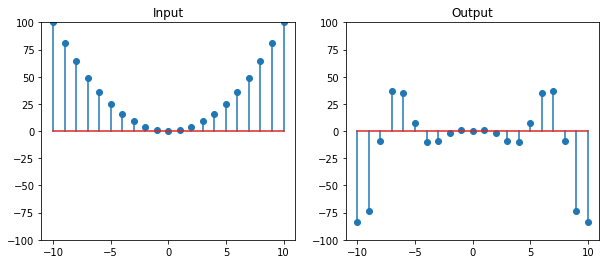

In [54]:
import numpy as np
import matplotlib.pyplot as plt

n_all = np.arange( -10, 11 )

x = np.power( n_all, 2. )
y = np.multiply( np.cos( n_all ), x )

fig, axs = plt.subplots( 1, 2, figsize = (10, 4) )

axs[0].stem( n_all, x )
axs[0].set_title( 'Input' )
axs[0].set_ylim( -100, 100 )
axs[1].stem( n_all, y )
axs[1].set_title( 'Output' )
axs[1].set_ylim( -100, 100 )

plt.show()

Now let's have a look at our Green's functions:

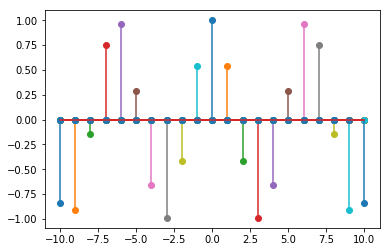

In [64]:
plt.figure( figsize = (6, 4) )

for color_idx, i in enumerate( n_all ):
    hi = np.cos( n_all )
    hi[n_all - i != 0] = 0.
    
    plt.stem( n_all, hi,
              linefmt = 'C{0}-'.format( color_idx % 10 ),
              markerfmt = 'C{0}o'.format( color_idx % 10 ) )
    
plt.show()

In this depiction, each color is a different Green's function (with some repeats, as it's impossible to run into some clashes with  colors! Recall, though, that each Green's function in this example is an impulse [$\cos(n)\,\delta(n-i)$], and so each stem is its own Green's function!).

A few things jump out here. First, the Green's functions are **not** homogeneous in time at all; that is, they do not look like shifted replicates of one another. Allthough we haven't explicitly stated it yet, this fits in with our impression that this system is not time-invariant; if it were, then each Green's function (which is the response of the system to a shifted impulse) should have the same *shape*, just shifted!

Second, take a look at all three plots above together. What we discovered earlier is that, for a linear system, the output is determined by the Green's functions: the input values at each point are used to *scale* the corresponding Green's function, which are then added together to form the output. Do you see that here? The input values ($x(n) = n^2$) are used to scale the vectors shown in the colorful Green's function plot (which are just impulses scaled by $\cos(n)$), which results in the output.

<a id="223"></a>
***
## 2.2.3. Linear, translation-invariant (LTI) systems

Linearity and translation-invariance are like peanut butter and chocolate—the real magic happens when they come together.

To see why this happens, let's return to where we left off in the section on *linearity*. We had discovered that any linear system's reponse to an input can be decomposed into responses to individual shifted impulses; for example, for a discrete system $T: x \mapsto y$, this took the form of

$$ y(n) = \sum_{i=-\infty}^\infty x(i)\,h_i(n) $$

where

$$ h_i(n) = T(\delta(n-i))$$

gives the response by the system to a shifted impulse. Noting that we can express $\delta(n-i) = D_i \delta(n)$ in terms of the delay operator, what happens if we assume that $T$ is not only *linear*, but also *translation-invariant*? Intuitively, this should mean that all of these responses to a shifted impulses should be *the same response*, just shifted; symbolically, we can derive this by noting that

$$
\begin{eqnarray*}
    h_i(n) & = & T(\delta(n-i)) \\
     & = & T(D_i(\delta(n))) \\
     & = & D_i(T(\delta(n)))\textrm{ by translation-invariance}
\end{eqnarray*}
$$

So now we've discovered the true kernel of what makes a linear *and* translation-invariant (or **LTI**) system tick: their response to signals is *completely determined* by their response to a single impulse at the origin! Because of the importance of this function—called, unsurprisingly, the **impulse response**—we give it a special notation:

$$ h(n) = T(\delta(n)) $$

and note that this gives a common form to all of the Green's functions for a LTI system:

$$
\begin{eqnarray*}
    h_i(n) & = & D_i( h(n) ) \\
     & = & h(n-i)
\end{eqnarray*}
$$

That is, all of the Green's functions are translated versions of the same impulse response. Knowing this, we can return to our expression for the output of an LTI system, and rewrite it in terms of the *impulse response*:

$$
\begin{eqnarray*}
    y(n) & = & \sum_{i=-\infty}^\infty x(i)\,h_i(n) \\
     & = & \sum_{i=-\infty}^\infty x(i)\,h(n-i)
\end{eqnarray*}
$$

Now, recall from above our observation that *every signal* can be decomposed into scaled and shifted impulses:

$$ x(n) = \sum_{i=-\infty}^\infty x(i)\,\delta(n-i) $$

The form above is *very* similar; but now, we see that the output of an LTI system is decomposable into scaled and shifted *impulse responses*; that is, each shifted impulse in the original signal is transformed by the system into a shifted impulse *response*. This is, fundamentally, the action of an LTI system: to plop down an impulse response $h(n-i)$ at every input impulse $\delta(n-i)$, scaled appropriately.

The summations we saw above involving two signals of the form

$$ \sum_{i=-\infty}^\infty a(i)\,b(n - i) $$

are so fundamental to LTI system theory that we give them their own name: **convolution**. Note that in the convolution sum, there is a "free" variable, $n$ in this case; therefore, it stands to reason that the result of a convolution sum isn't just an individual value, but in fact, an entire *signal*. In convolution, the first input signal $a$ gives the *scale* factors (by analogy with $x(i)$ in the sums above) at each shift, while the second signal $b$ gives the *vector* that is shifted and scaled (like the shifted impulse response $h(n-i)$ above).

<a id="example_convolution"></a>
***

#### **Example**: Convolution

Above we dealt with a *simple moving average* system. Let's implement another averaging filter for data—but this time, let's use a different impulse response.

One relatively famous smoothing system is *Spencer's 15-point moving average*, which has the remarkable property that it leaves cubic polynomial inputs completely unaltered.

We can visualize the impulse response of this system:

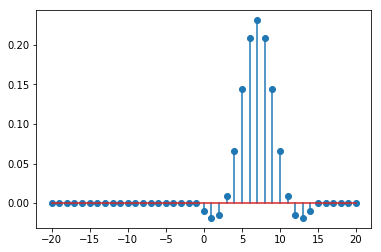

In [149]:
import numpy as np
import matplotlib.pyplot as plt

spencer_a = np.array( [ -3, -6, -5, 3, 21, 46, 67, 74, 67, 46, 21, 3, -5, -6, -3] )

n_per_side = 20
n_all = np.arange( -n_per_side, n_per_side + 1 )
h = np.zeros( n_all.shape )
h[n_per_side:(n_per_side+spencer_a.shape[0])] = spencer_a / np.sum( spencer_a )

plt.stem( n_all, h )
plt.show()

Let's apply this system to some stock data by **convolving** the data with this impulse response. First, it's worth taking a second to illustrate what's going on with the convolution sum under the hood. As mentioned above, when we convolve two signals, as we do with the response to an LTI system:

$$ y(n) = \sum_{i=-\infty}^\infty x(i)\,h(n-i) $$

we use the second signal to give us the *vector* component, which determines the shape of the signal that is laid down at that step; and we use the first signal to give us the *scalar* component, which determines the amplitude of that applied signal vector. Let's illustrate this (by using every 5th sample, for clarity):

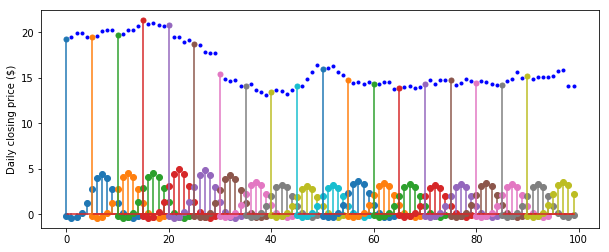

In [154]:
import yfinance
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt

cur_ticker = 'M'
ticker = yfinance.Ticker( cur_ticker )

ticker_history = ticker.history( period = '1y' )
ticker_close = ticker_history.loc[:, 'Close']

n_all = np.array( [ i for i, x in enumerate( ticker_close ) ] )

x = ticker_close

h = np.zeros( n_all.shape )
h[0:spencer_a.shape[0]] = spencer_a / np.sum( spencer_a )

n_look = 100

plt.figure( figsize = (10, 4) )
plt.plot( n_all[:n_look], x[:n_look], 'b.' )

for color_idx, i in enumerate( range( 0, n_look - 5, 5 ) ):
    hi = np.zeros( (n_look,) )
    hi[i:] = h[:(n_look - i)]
    plt.stem( n_all[:n_look][i:i+spencer_a.shape[0]], x[i] * hi[i:i+spencer_a.shape[0]],
              linefmt = 'C{0}-'.format( color_idx % 10 ),
              markerfmt = 'C{0}o'.format( color_idx % 10 ) )
    plt.plot( np.array( [i, i] ), np.array( [ hi[i], x[i] ] ), 'C{0}-'.format( color_idx % 10 ))
    plt.plot( np.array( [i] ), np.array( [x[i]] ), 'C{0}.'.format( color_idx % 10 ),
              markersize = 10 )
    
plt.ylabel( 'Daily closing price ($)' )
plt.show()

The stem plots at the bottom are what results at each sample: these are the scaled and shifted impulse responses for the correspondiing samples in the trace above them. These shifted and scaled impulse responses are then added together, yielding the final convolution result:

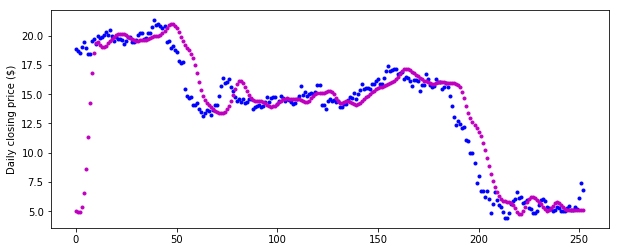

In [108]:
import yfinance
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt

cur_ticker = 'M'
ticker = yfinance.Ticker( cur_ticker )

ticker_history = ticker.history( period = '1y' )
ticker_close = ticker_history.loc[:, 'Close']

n_all = np.array( [ i for i, x in enumerate( ticker_close ) ] )

x = ticker_close

h = np.zeros( n_all.shape )
h[0:spencer_a.shape[0]] = spencer_a / np.sum( spencer_a )

# Manually perform convolution
y = np.zeros( n_all.shape )
for n_idx, n in enumerate( n_all ):
    cur_sum = 0.
    for i_idx, i in enumerate( n_all ):
        cur_sum += x[i_idx] * h[n_idx - i_idx]
    y[n_idx] = cur_sum

plt.figure( figsize = (10, 4) )
plt.plot( n_all, x, 'b.', label = 'Input' )
plt.plot( n_all, y, 'm.', label = 'Output' )
plt.ylabel( 'Daily closing price ($)' )
plt.show()

(Note that, once again, our system has an "edge effect" resulting from the fact that we treat our signals as padded with extra zeros on the sides; at the beginning of the signal, there are not enough time points to "fill up" the entire impulse response with data, and as such, an artifact ensues wherever there is a lack of data. We can ameliorate this problem by providing *initial conditioins* for our system, as we will see later on.)

<a id="lti_action"></a>
***

### LTI systems are convolvers

The signal that *results* from the convolution of a signal $a$ with another signal $b$ is denoted $a \ast b$. For example, our above expression for the output of an LTI system

$$ y(n) = \sum_{i=-\infty}^\infty x(i)\,h(n-i) $$

can be compactly written

$$ y = x \ast h $$

So we see that, fundamentally, an LTI system **convolves inputs with its impulse response**.

<a id="example_convolution_reverb"></a>
***

#### **Example**: Convolution reverb

Let's see another example of how convolution can be used to compute the output of a system. In this case, we'll be performing an operation known in audio processing as **reverb**. Reverb is an effect that occurs when sound reflects off of surfaces, causing sound to persist even after the original source of that sound has stopped producing any noise. Although many modern reverb effects often usee mathematical modeling in order to create a wide array of sounds—some of which are beyond what can be realized in the physical world—one form of reverb, known as **convolutional reverb**, takes advantage of the properties of LTI systems to generate reverb from real-world data.

Say that you come across a factory, and the acoustics of that factory are particularly exciting to you, such that you'd like to make a (digital) audio signal $x(n)$ that was recorded in a studio *sound like* it was recorded in the factory. One way that we might do this is by modeling the *room* as an LTI system; that is, our audio *as it would sound recorded in the factory*, $y(n)$, is the output of a system $T_\mathrm{reverb}$ with the "clean" signal $x(n)$ as input:

$$ T_\mathrm{reverb}: x \mapsto y $$

We know from the theory developed above that this system acts by *convolving* the input with the system's impulse response:

$$ y = x \ast h_\mathrm{reverb} $$

But how do we determine this impulse response? Well, fundamentally, the impulse response is the system's response to an impulse; so, one reasonable way to determine the impulse response is to present the system with an impulse, and record the ensuing sound in the room! In the past, many different approximations of "impulses" were used for this purpose, including sounds like popping a balloon, or even shooting a blank inside the space; nowadays, we use more sophisticated techniques, but the principle is still the same.

Below is an example of an impulse that was recorded in our factory. First, we'll take a look at the shape of the impulse response:

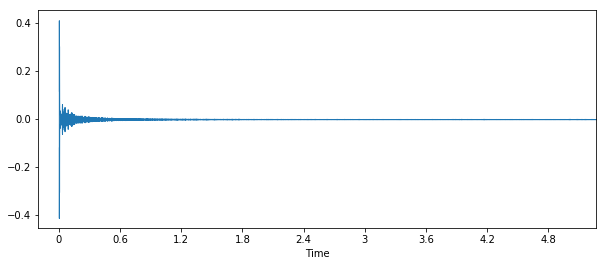

In [2]:
import librosa
import librosa.display
import IPython.display as ipd

import matplotlib.pyplot as plt

# Load the impulse response from disk
# h is the impulse response
# Fs is the sampling rate of the audio
h, Fs = librosa.load( 'data/ir_factory.wav', sr = 44100 )

# Plot the IR
plt.figure( figsize = (10, 4) )
librosa.display.waveplot( h, sr = Fs )

xl = plt.xlim()
plt.xlim( -0.2, xl[1] )

plt.show()

Notice that this impulse response has a tail extending out for a considerable duration. Let's take a listen to whit this impulse response sounds like:

In [3]:
# Play the signal as audio
ipd.Audio( h, rate = Fs )

Once again, we can hear the "reverberations" of the original impulse as this sound plays; as we will see, this gives us somewhat of an indication of what the effect of this system will be when we apply it to our input audio signal.

Speaking of which, let's spin up a track to use as a demonstration of this reverb system; we'll take an example [from SoundCloud](https://soundcloud.com/sin-ap-tc/swole-demo):

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/librosa/core/audio.py:161: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn('PySoundFile failed. Trying audioread instead.')


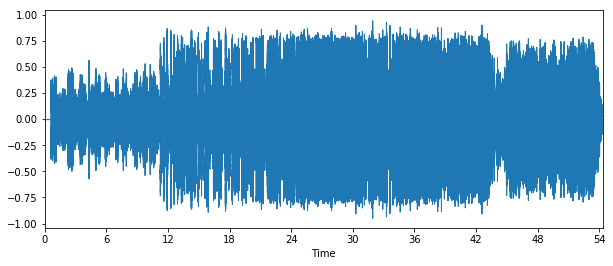

In [15]:
# Load the audio response from disk
# x is the input signal
# Fs is the sampling rate of the audio
x, Fs = librosa.load( 'data/karate.mp3', sr = 44100 )

plt.figure( figsize = (10, 4) )
librosa.display.waveplot( x, sr = Fs )
plt.show()

In [16]:
# Play the signal as audio
ipd.Audio( x, rate = Fs )

Now, the magic: to determine the system's output, we will *convolve* our input signal with the system's impulse response. This time, rather than manually doing the convolution sum (as we did with the Spencer smoother above), we'll take advantage of the implementation built into [SciPy](https://docs.scipy.org/doc/scipy/reference/generated/scipy.signal.fftconvolve.html#scipy.signal.fftconvolve). (We will learn how this implementation works in the next chapter!)

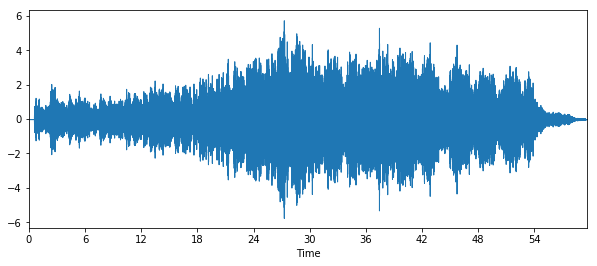

In [20]:
import scipy.signal

y = scipy.signal.fftconvolve( x, h )

plt.figure( figsize = (10, 4) )
librosa.display.waveplot( y, sr = Fs )
plt.show()

Let's take a listen to the result:

In [21]:
ipd.Audio( y, rate = Fs )

Does it sound better? Probably not. It does, however, now sound like this song is being performed in the middle of a factory floor! Just listen to the very end, where you can hear the reverberations trail off even as the original input signal has ended. It really *sounds* as if the song is being played in a different room.

It's important to mention here that the model of the effects of a room on sound as being an LTI system are only an *approximate* one; there are, for example, numerous factors in the physics of sound for a given room that might make its behavior nonlinear. However, the approximatioin is close enough in many applications—and produces such an acoustically desirable effect—that it is the basis for many [commercial](https://www.avid.com/plugins/space) [audio](https://www.audioease.com/altiverb/) [products](https://www.ableton.com/en/packs/convolution-reverb/).

<a id="lti_continuous"></a>
***

### The continuous case

Now that we've seen some of the inner workings of LTI systems, let's expand our theory to cover *continuous* signals. We can do this in a completely analogous way to how we proceeded for discrete signals, above. First, we'll start where we left off for a *linear* system $T: x \mapsto y$—namely, that the output is entirely determined by the system's *Green's functions*:

$$ y(t) = \int_{-\infty}^\infty x(\tau)\,h_\tau(t)\,\mathrm{d}\tau $$

where we define the $h_\tau$ functions by the response to a *shifted impulse*,

$$ h_\tau(t) = T(\delta(t-\tau)) $$

However, once again, we note that, if $T$ is *translation-invariant*, then by definition, all of these Green's functions must be *translated versions* of the same **impulse response**:

$$
\begin{eqnarray*}
    h_\tau(t) & = & T(\delta(t-\tau)) \\
     & = & T(D_\tau(\delta(t)) \\
     & = & D_\tau(T(\delta(t)) \\
     & = & D_\tau(h(t)) \\
     & = & h(t - \tau)
\end{eqnarray*}
$$

where we define

$$ h(t) = T(\delta(t)) $$

as the system's impulse response, analogous to the discrete case above. Now, then, our output expression for the system simplifies to

$$ y(t) = \int_{-\infty}^\infty x(\tau)\,h(t - \tau)\,\mathrm{d}\tau $$

which we recognize is the *continuous* equivalent of placing a scaled and shifted replica of $h$ at every point, in the infinitessimal limit.

As with the discrete case above, integrals of the form

$$ \int_{-\infty}^\infty a(\tau)\,b(t-\tau)\,\mathrm{d}\tau $$

are particularly important for LTI systems analysis, and once again we denote this operation **convolution**. By parallel with discrete convolution, note that there is a free variable in the integral, $t$; therefore, it stands to reason that the result is not a *single value* of the integral, but rather a *continuous signal* with a resultant value for each value of $t$. We denote this signal that is the result of convolving two signals $a$ and $b$ by $a \ast b$; for example, the expression above for the output of a continuous LTI system can be compactly written

$$ y = x \ast h $$

just as for the discrete case!

<a id="figure_convolution_continuous"></a>
***

#### **Figure**: Another interpretation of continuous convolution

When interpreting the continuous convolution integral, our description of discrete convolution as "depositing" shifted copies of $b$ scaled by the values of $a$ falls apart a little bit, because of the presence of infinitessimal limits in the integration. Although this interpretation serves as a good intuitive model, we can also construct a more direct view of the convolution integral by looking straight at the formula.

For a continuous LTI system $T: x\mapsto y$ with output defined by

$$ y(t) = \int_{-\infty}^\infty x(\tau)\,h(t-\tau)\,\mathrm{d}\tau $$

we can imagine fixing a value of $t$ and actually evaluating the integral over the variable $\tau$. As a function of $\tau$, we see that $h(t-\tau)$ is actually the impulse response $h$ *centered at $t$ and flipped in $\tau$*. So at this given point in $t$, we are able to define a function of $\tau$

$$ x(\tau)\,h(t-\tau) $$

by taking the pointwise product of $x$ and $h$ across $\tau$. We then integrate this function with respect to $\tau$ to determine the value of $y$ at this fixed value of $t$. In this way, we see that the impulse response $h$ is a sort of "window" that "adds up" (or integrates) the history of the input signal $x$.

Let's take a look at how this looks with an example. First, let's settle on an impulse response and an input signal:

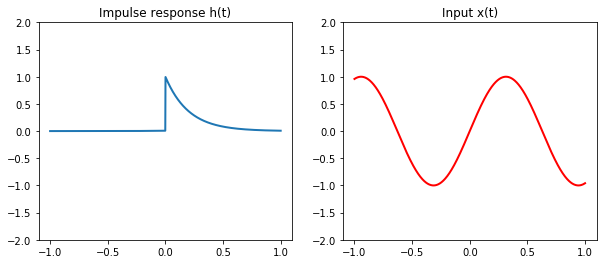

In [87]:
import numpy as np
import matplotlib.pyplot as plt

fig, axs = plt.subplots( 1, 2, figsize = (10, 4) )

t_disp = np.linspace( -1, 1, 1000 )

h[t_disp >= 0] = np.exp( -alpha * t_disp[t_disp >= 0] )
x = np.sin( 5. * t_disp )

axs[0].plot( t_disp, h, lw = 2 )
axs[0].set_ylim( -2, 2 )
axs[0].set_title( 'Impulse response h(t)' )
axs[1].plot( t_disp, x, 'r-', lw = 2, )
axs[1].set_ylim( -2, 2 )
axs[1].set_title( 'Input x(t)' )
plt.show()

We can build an animation of the process of determining the output of this system $y(t)$ from these two signals, as shown below $\ldots$ more exposition $\ldots$

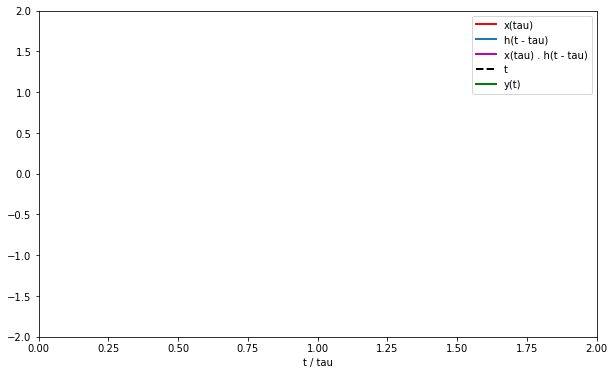

In [72]:
from matplotlib import animation, rc
from IPython.display import HTML

rc( 'animation', html = 'html5' )

# First set up the figure, the axis, and the plot element we want to animate
fig, ax = plt.subplots( figsize = (10, 6) )

ax.set_xlim( ( 0, 2) )
ax.set_ylim( (-2, 2) )

line_x, = ax.plot( [], [], 'r-', lw = 2, label = 'x(tau)' )
line_h, = ax.plot( [], [], lw = 2, label = 'h(t - tau)' )

line_integrand, = ax.plot( [], [], 'm-', lw = 2, label = 'x(tau) . h(t - tau)' )

line_t, = ax.plot( [], [], 'k--', lw = 2, label = 't' )
line_y, = ax.plot( [], [], 'g-', lw = 2, label = 'y(t)' )
line_y_cur, = ax.plot( [], [], 'g.', markersize = 10 )
ax.set_xlabel( 't / tau' )
ax.legend()

In [80]:
# initialization function: plot the background of each frame
def init():
    line_x.set_data([], [])
    line_h.set_data([], [])
    line_integrand.set_data([], [])
    line_t.set_data([], [])
    line_y.set_data([], [])
    line_y_cur.set_data([], [])
    return (line,)

output_history = np.zeros( tau.shape )
for t_idx, t in enumerate( tau ):
    alpha = 5.
    h = np.zeros( tau.shape )
    h[tau <= t] = np.exp( -alpha * (t - tau[tau <= t]) )
    x = np.sin( 5. * tau )
    integrand = np.multiply( x, h )
    cur_int = np.trapz( integrand, x = tau )
    
    output_history[t_idx] = cur_int

# animation function. This is called sequentially
def animate(i):
    h = np.zeros( tau.shape )
    
    t = tau[i * 5]
    
    alpha = 5.
    h[tau <= t] = np.exp( -alpha * (t - tau[tau <= t]) )
    
    x = np.sin( 5. * tau )
    
    integrand = np.multiply( x, h )
    
    cur_int = np.trapz( integrand, x = tau )
    
    line_x.set_data(tau, x)
    line_h.set_data(tau, h)
    line_integrand.set_data(tau, integrand)
    
    line_t.set_data( t * np.array( [1, 1] ), np.array( [-2, 2] ) )
    line_y.set_data( tau[tau < t], output_history[tau < t] )
    line_y_cur.set_data( np.array( [t] ), np.array( [cur_int] ) )
    
    return (line,)

# call the animator. blit=True means only re-draw the parts that have changed.
anim = animation.FuncAnimation(fig, animate, init_func=init,
                               frames=200, interval=40, blit=True)

In [81]:
anim

Here it's important to note that the traces $x$, $h$, and $x(\tau)\,h(t-\tau)$ are all functions of $\tau$, with $t$ being considered constant in a given frame; from that framework, the integral of $x(\tau)\,h(t-\tau)$ (the magenta trace) with respect to $\tau$ is used to determine the value of $y$ at the current value of $t$ (green dot); looking at these values across time gives us the full output trace $y(t)$ (green line).

This is also a good demonstration of the "windowing" property of a system's impulse response: notice how the magenta trace (which is integrated to yield the system's output) "looks like" the input trace (red), but "weighted" by the shifting impulse response (blue). Fluctuations in $x$ that are *close* to the current time $t$—where there is the most amplitude in the impulse response—are weighted more in the output for that time point, whereas input values that are more distant are *attenuated* by the exponential decay of the impulse response.

<a id="convolution_commutative"></a>
***

### Convolution is commutative

The convolution operation ($\ast$) itself has a number of properties that are quite useful, especially given our observation that convolution is the fundamental operation of LTI systems.

First, we have the following result:

#### **Theorem** (Convolution is commutative)
>Let $p(a)$ and $q(a)$ be two (discrete or continuous) signals. Then
>
>$$ p \ast q = q \ast p $$

##### **Proof** (Discrete case)
By definition, we have that

$$ (p \ast q)(n) = \sum_{i=-\infty}^\infty p(i)\,q(n-i) $$

Let $k = n - i$; then, $i = n - k$, and the inside of our sum becomes

$$ p(i)\,q(n-i) = p(n-k)\,q(k) = q(k)\,p(n-k) $$

This would be the perfect form for another convolution sum if only we were summing over $k$ instead of $i$; but, note that, our sum is completely preserved if we sum over $k$ instead of $i$ (that is, we hit all of the same terms, albeit in the opposite order!); hence, we may make the substitution

$$ (p \ast q)(n) = \sum_{k=-\infty}^\infty q(k)\,p(n-k) = (q \ast p)(n) $$

by the definition of discrete convolution.

##### **Proof** (Continuous case)
Once again we start with the definition of convolution:

$$ (p \ast q)(t) = \int_{-\infty}^\infty p(\tau)\,q(t-\tau)\,\mathrm{d}\tau $$

Now, we use the change of variables formula from single variable calculus:

$$ \int_a^b f(g(\tau))\,g'(\tau)\,\mathrm{d}\tau = \int_c^d f(u)\,\mathrm{d}u $$

where $u = g(x)$. Here, we use the change of variables $u = t - \tau$. We have two considerations: first, we note that $g'(\tau) = -1$; hence, we need to negate our result. Noting that $\tau = t - u$, this gives us

$$ (p \ast q)(t) = -\int_c^d p(t - u)\,q(u)\,\mathrm{d}u $$

However, we also must be cognizant of the *bounds of integration*; indeed, when $\tau \to \infty$, $u \to -\infty$, and *vice versa*. Hence, plugging our bounds, we have:

$$
\begin{eqnarray*}
    (p \ast q)(t) & = & -\int_{\infty}^{-\infty} p(t - u)\,q(u)\,\mathrm{d}u \\
     & = & \int_{-\infty}^\infty q(u) p(t - u)\,\mathrm{d}u \\
     & = & (q \ast p)(t)
\end{eqnarray*}
$$

by definition of continuous convolution.

This is a very intriguing finding; for example, it tells us that our ideas of "input" and "impulse response" for an LTI system are symmetric, in a sense. Consider an LTI system $T: x \mapsto y$; the output of this system is governed by the convolution

$$ y = x \ast h $$

However, as we've shown before, this is precisely equal to $h \ast x$, because of the commutativity of convolution; thus, we may treat the *input signal* as our *impulse response*, and our *impulse response* as the *input*, and the output result is completely identical!

<a id="convolution_associative"></a>
***

### Convolution is associative

We saw above that we ccan *rearrange* convolved signals. What tools do we have for *combining* them?

#### **Theorem** (Convolution is associative)
>Given (discrete or continuous) signals $p(a)$, $q(a)$, and $r(a)$,
>
>$$ (p \ast q) \ast r = p \ast (q \ast r) $$

##### **Proof** (Discrete case)
Evaluating the outer convolution first, we find that, by definition,

$$
\begin{eqnarray*}
    ((p \ast q) \ast r)(n) & = & \sum_{j=-\infty}^{\infty} (p \ast q)(j)\,r(n-j) \\
     & = & \sum_{j=-\infty}^{\infty} \left(\sum_{i=-\infty}^\infty p(i)\,q(j-i) \right)\,r(n-j)
\end{eqnarray*}
$$

(Note that here, the inner sum is precisely $(p\ast q)(j)$.)

Now, $r(n-j)$ is constant in $i$, so we can treat this term as being within the inner sum (as a constant factor) without changing the result:

$$ ((p \ast q) \ast r)(n) = \sum_{j=-\infty}^{\infty} \sum_{i=-\infty}^\infty p(i)\,q(j-i)\,\,r(n-j) $$

Now, under the assumption that this double sum **absolutely converges**—$\ldots$explanation$\ldots$—we may interchange the order of summation, *i.e.*,

$$
\begin{eqnarray}
    ((p \ast q) \ast r)(n) & = & \sum_{i=-\infty}^{\infty} \sum_{j=-\infty}^\infty p(i)\,q(j-i)\,r(n-j) \\
     & = & \sum_{i=-\infty}^\infty p(i)\sum_{j=-\infty}^\infty q(j-i)\,r(n-j)\quad\textrm{(*)}
\end{eqnarray}$$

with the second step coming from the observation that $p(i)$ is constant in $j$, and can therefore be pulled out of the inner sum. Now, we have our first term, $p(i)$, which will be unchanged in the final result; we would like to get the last two terms into the form

$$ (q\ast r)(n - i) = \sum_{k=-\infty}^\infty q(k)\,r(n-i-k) $$

as doing so will put our large summation into the form

$$ ((p \ast q) \ast r)(n) = \sum_{i=-\infty}^{\infty} p(i)\,(q\ast r)(n-i) = (p \ast (q \ast r))(n) $$

which will complete the proof. However, note that if we make the following substitution in (*):

$$ k = j - i,\quad \therefore j = i + k \Rightarrow n - j = n - i - k $$

then we obtain precisely our desired result.

##### Proof (Continuous case)
**TODO**

<a id="cascaded_systems"></a>
***

### Cascaded systems

The commutativity and associativity of convolution have a few interesting consequences. First, consider two systems with impulse responses $h_1$ and $h_2$ that are **cascaded**, as in the following diagram:

<img src="img/f-2-2-cascade-assoc-01.png"/>

As shown in the diagram, the output of the cascade is $(x \ast h_1)\ast h_2$. First, it is interesting to note that, by the associativity of convolution, we can actually **combine** these two systems into one by convolving the systems' impulse responses:

$$ (x \ast h_1)\ast h_2 = x \ast (h_1 \ast h_2) $$

We can go even further than this, though! Since convolution is also commutative, we can further rearrange this expression:

$$
\begin{eqnarray*}
    x \ast (h_1 \ast h_2) & = & x \ast (h_2 \ast h_1) \\
     & = & (x \ast h_2) \ast h_1
\end{eqnarray*}
$$

So we see that if the cascade is performed in the **reverse order**, the results are still the same!

<a id="convolution_distributive"></a>
***

### Convolution is distributive

Convolution also plays well with the vector space structure of signals:

#### **Theorem**: (Convolution is distributive)
>Given (discrete or continuous) signals $p(a)$, $q(a)$, and $r(a)$,
>
>$$ p \ast (q + r) = p \ast q + p \ast r $$

##### **Proof** (Discrete case)
By definition, we have that

$$
\begin{eqnarray*}
    (p \ast (q + r))(n) & = & \sum_{i=-\infty}^\infty p(i)\,(q + r)(n - i) \\
     & = & \sum_{i = -\infty}^\infty p(i)(q(n-i) + r(n-i))\quad\textrm{(*)} \\
     & = & \sum_{i=-\infty}^\infty (p(i)\,q(n-i) + p(i)\,r(n-i)) \\
     & = & \sum_{i=-\infty}^\infty p(i)\,q(n-i) + \sum_{i=-\infty}^\infty p(i)\,r(n-i)\quad\textrm{(**)} \\
     & = & (p \ast q)(n) + (p \ast r)(n)
\end{eqnarray*}
$$

(\*) follows from the definition of vector space operations on signals we described above; (\*\*) follows from the *linearity* of summation (*i.e.*,

$$ \sum_i(a_i + b_i) = \sum_i a_i + \sum_i b_i $$

##### **Proof** (Continuous case)
**TODO**

<a id="parallel_systems"></a>
***

### Parallel systems

Let's see how distributivity influences another system architecture. This time, we'll take a look at the **parallel** system, depicted below:

<img src="img/f-2-2-parallel-distrib-01.png"/>

Here, we split the input signal $x$ into two systems, with impulse responses $h_1$ and $h_2$. The ouptuts of these two parallel systems are then *added together*, giving the total output $ x \ast h_1 + x \ast h_2$. However, once again, we see that there is an opportunity to simplify what is going on:

$$ x \ast h_1 + x \ast h_2 = x \ast (h_1 + h_2) $$

It appears that our parallel system is actually equivalent to a single system where the impulse responses of the individual elements are *added together*. Note the similarity with the *cascaded* system we saw above: there, in contrast, when the two elements were combined together, their impulse responses were *convolved*.

<a id="impulse_identity"></a>
***

### The impulse is the convolution identity

As one final point on the *algebra* of convolution, it's worthwhile to mention a relationship that we have already brought up when representing signals. Take $x(n)$ a discrete signal; then, as we saw above, we can reprsent $x$ as a sum of scaled and shifted impulses by

$$ x(n) = \sum_{i=-\infty}^\infty x(i)\,\delta(n - i) $$

This form should be extremely familiar now: it's a convolution sum! Indeed, this formula is telling us that

$$ x = x \ast \delta $$

Since we also have shown that convolution is commutative, we also know that

$$ x = \delta \ast x $$

and hence, $\delta$ is a two-sided **identity** for convolution.

Similarly, for the continuous case, we showed that a signal $x(t)$ has the representation

$$ x(t) = \int_{-\infty}^\infty x(\tau) \delta(t - \tau)\,\mathrm{d}\tau $$

Again, this is precisely the continuous convolution

$$ x = x \ast \delta $$

So we see that $\delta$ is also the identity of convolution in the continuous case.

<a id="lti_memoryless"></a>
***

### Memorylessness

Some of the more general properties of systems we identified above have special presentations for LTI systems, owing to the additional mathematical structure provided by linearity and translation-invariance.

The first property we'll explore is that of **memorylessness**. Above we looked at how a memoryless system can be used as an audio distortion effect. However, as it happens, memoryless LTI systems are quite boring. Take an example discrete system $T: x \mapsto y$ with impulse response $h$; this system's output is determined, in general, by

$$ y(n) = \sum_{i=-\infty}^\infty x(i)\,h(n-i) $$

However, for $T$ to be memoryless, $y(n)$ must only depend on $x(n)$; equivalently, all of the terms of the sum must equal $0$ except for $i = n$; hence, we must have that

$$ h(n-i) = 0,\quad \forall i \neq n $$

Put another way, $h(n)$ must be *nonzero only at* $n = 0$.

**TODO** Continuous case

Since $h$ is nonzero at only a single sample, we have another way to phrase this in terms of another fundamental signal:

#### **Proposition**
> A (discrete or continuous) LTI system $T$ is **memoryless** iff its impulse response is of the form
>
> $$ h(a) = \beta\,\delta(a) $$
>
> for some $\beta \in \mathbb{R}$.

What does the output look like of such a system? Well, recall that $\delta$ is the identity of convolution; hence, we have

$$ y = x \ast h = x \ast (\beta\,\delta) = \beta(x \ast \delta) = \beta\,x $$

So it seems that the only memoryless LTI systems multiply their input by a fixed constant!

<a id="lti_invertability"></a>
***

### Invertability

Often we're interested in whether a system can be "undone" perfectly. As we saw above, the property of interest here is **invertibility**: for a system $T$, is there another system $T'$ such that $T'$ "undoes" $T$, or,

$$ T'(T(x)) = x $$

for any input signal $x$. Suppose now that we have an invertible $T$ with its inverse $T^{-1}$ that are both *LTI*. Then, both systems are characterized by their impulse responses; denote them $h$ and $h_\textrm{inv}$, respectively. By the equation above, and from our definition of LTI system output, we must have that

$$
\begin{eqnarray*}
    (x \ast h) \ast h_\textrm{inv} & = & x \\
    x \ast (h \ast h_\textrm{inv}) & = & x \ast \delta \\
    h \ast h_\textrm{inv} & = & \delta
\end{eqnarray*}
$$

So now we see that the two systems $T$ and $T^{-1}$ being inverses in the sense of *systems* has a parallel in the world of the systems' *impulse responses*. In a very analogous way to the multiplicative inverses of regular numbers, when two signals $a$ and $a'$ satisfy the following relationship with the *identity of convolution* $\delta$:

$$ a \ast a' = \delta $$

we call $a'$ the **inverse element** of $a$, and denote it $a^{-1}$.

We see, then, that an LTI system having an inverse (in the definition of *systems*) corresponds to the system's impulse response having an inverse (in the definition of *convolution algebra*).

<a id="lti_stability"></a>
***

### Stability

Another critical property we've looked at is **BIBO stability**, which interrogates whether a system guarantees that *bounded inputs* yield *bounded outputs*. For LTI systems—where the system's behavior is determined completely by its impulse response—we might imagine that this property has something to do with how "big" the impulse response is; if the impulse response has more "weight", in a certain sense, then one might find that the convolution sum or integral "blows up" because of that additional "mass". This intuition turns out to be quite close to the truth!

#### **Theorem** (BIBO stability: discrete LTI case)
> Let $T$ be a discrete system with impulse response $h(n)$; then, $T$ is **BIBO stable** if $h$ is **absolutely summable**:
>
> $$ \sum_{n=-\infty}^\infty |h(n)| = \|h\|_1 < \infty $$

(Note that the sum above, denoted $\|h\|_1$, is also known as the **$1$-norm** of $h$.)

##### Proof
($\Leftarrow$) Suppose $x$ is bounded, such that $x(n) \leq B$ for all $n$. Taking the absolute value of $T$'s output, we find that

$$
\begin{eqnarray*}
    |y(n)| & = & \left|\sum_{i=-\infty}^\infty x(i)\,h(n-i)\right| \\
     & \leq & \sum_{i=-\infty}^\infty |x(i)\,h(n-i)|\quad\textrm{(*)} \\
     & = & \sum_{i=-\infty}^\infty |x(i)| \, |h(n-i)| \\
     & \leq & \sum_{i=-\infty}^\infty B \, |h(n-i)| \\
     & = & B \sum_{i=-\infty}^\infty |h(i)| = B \|h\|_1
\end{eqnarray*}
$$

(Where (\*) follows from the triangle inequality.) If $h$ is absolutely summable, with $\|h\|_1 < \infty$, then $|y(n)| \leq B \|h\|_1$, which is finite; hence, $y$ is bounded. Since this is true for all bounded inputs $x$, it follows that $T$ is BIBO stable.

#### **Theorem** (BIBO stability: continuous LTI case)
> Let $T$ be a continuous system with impulse response $h(t)$; then, $T$ is **BIBO stable** if $h$ is **absolutely integrable**:
>
> $$ \int_{-\infty}^\infty |h(t)|\,\mathrm{d}t = \|h\|_1 < \infty $$

##### **Proof**
**TBD**

<a id="lti_causality"></a>
***

### Causality

One last property we'll have a look at here is **causality**. Recall that causality, intuitively, means that the output $y(a)$ of a system at a point $a$ does not depend on the future values of the input $x(b)$, $b > a$. As we saw above, this can be formalized by flipping the question around: a system is *causal* if two signals $x_1$ and $x_2$ with the same *history* generate the same results $y_1$ and $y_2$:

$$ x_1(a) = x_2(a),\,a < a_0 \quad \Rightarrow \quad y_1(a) = y_2(a),\,a < a_0 $$

Now, for an LTI system $T$, we consider what happens when we send an *impulse* as input. Note that, by the definition of either the discrete or continuous $\delta$,

$$ \delta(a) = 0,\,a < 0 $$

Imagining the right hand side of this as a second signal $x_0(a) = 0$, we must have the relationship

$$ h(a) = y_0(a),\,a < 0 $$

where $y_0$ is the output of our system to the input $x_0=0$. But what is this output? Consider an arbitrary input to our system, $x \mapsto y$. Then, because $T$ is linear, we have that

$$ T(\beta\,x) = \beta T(x) = \beta\,y $$

for any scalar $\beta \in \mathbb{R}$. But what happens if $\beta$ is $0$? Then we have:

$$ T(0\,x) = T(0) = 0\,T(x) = 0\,y = 0 $$

Hence, our output $y_0$ for an input of $0$ must be precisely $0$. This means that

$$ h(a) = 0,\,a < 0 $$

So we see that causal LTI systems' impulse response is zero before the origin. As it happens, this condition is both necessary *and* sufficient! To see why in the discrete case, let's move in the opposite direction: suppose that $T$ is a discrete LTI system with impulse response $h$, such that

$$ h(n) = 0,\,n<0 $$

Now, our output to the system is given by the convolution sum

$$ y(n) = \sum_{i=-\infty}^\infty x(i)\,h(n-i) $$

However, our condition allows us to truncate this sum above, as the terms for $h(n-i)$ where $i > n$ are all zero:

$$ y(n) = \sum_{i=-\infty}^n x(i)\,h(n-i) $$

Now, suppose we have two inputs $x_1$ and $x_2$ that are identical for $n < n_0$; then, notice that for any $n < n_0$, the output values $y_1(n)$ and $y_2(n)$ determined by this sum—in which $i$ runs only up to $n < n_0$—includes only terms for which $x_1$ and $x_2$ are identical. Without the restriction on the bounds of the sum imposed by our condition, we could include terms $x(i)$ for $i \geq n_0$ in the sum, which would cause our outputs to differ; however, this constraint makes it so that we only can use terms which guarantee that our outputs $y_1$ and $y_2$ are exactly the same:

$$
\begin{eqnarray*}
    y_1(n) & = & \sum_{i=-\infty}^n x_1(i)\,h(n-i) \\
    y_2(n) & = & \sum_{i=-\infty}^n x_2(i)\,h(n-i) \\
    x_1(i) & = & x_2(i),\quad i < n_0 \\
    \therefore y_1(n) & = & y_2(n),\quad n < n_0
\end{eqnarray*}
$$

We can summarize these results neatly:

#### **Proposition**
> A (discrete or continuous) LTI system $T$ is **causal** iff its impulse response $h$ satisfies
>
> $$ h(a) = 0,\quad a < 0 $$

<a id="224"></a>
***

## 2.2.4. Linear constant-coefficient equations

Above we took a look at the behavior of the *causal moving average* system $T_{\textrm{MA}(N)}:x \mapsto y$, defined by the equation

$$ y(n) = \frac{1}{N} \sum_{k=0}^{N-1} x(n-k) $$

So, for example, for $N = 4$ we might have something like

$$ y(n) = \frac{1}{4} x(n) + \frac{1}{4} x(n-1) + \frac{1}{4} x(n-2) + \frac{1}{4} x(n-3) $$

This equation specifies $y(n)$ at a particular value of $n$ in terms of a **finite** number of known values of $x$ at time points in the past and present (*i.e.*, *shifted* copies of $x$). Although all LTI systems can be defined in terms of *infinite* sums of shifted versions of $x$ (*i.e.*, convolution), not all systems can be specified in a finite number of terms. In fact, one need not look too far before stumbling into one!

Take, for example, the **exponential moving average (EMA)**. This system takes a different approach to averaging the input data: rather than directly computing an $N$-sample average for every output sample $n$, the EMA uses a **recursive** relation to *update* previous samples' output values with new information. Hence, the EMA system $T_{\textrm{EMA}(a)}: x \mapsto y$, with $a \in (0,1)$ has a critical difference in its defining equation:

$$ y(n) = a\,y(n-1) + (1-a)\,x(n) $$

Here we see that the current value of $y$ is taking a little piece of $y$'s past and combining it with a (complementary) piece of $x$ at the present. Notice, however, that now the defining equation of $y(n)$ actually has dependence on $y$ itself, not just $x$!

Suppose that we were attempting to construct $y$ at sample $0$ based on a given input $x$. How would we begin? Well, our defining equation for $n = 0$ would read

$$ y(0) = a\,y(-1) + (1-a)\,x(0) $$

However, how do we know $y(-1)$? We could go back a step, and use the defining equation for $n = -1$; but, alas, this is no good either—for then, we would be left wondering what $y(-2)$ is, and so on down the rabbit hole.

To solve this problem, we need more information—specifically, **initial conditions** about $y$. If we knew, for example, $y(-1)$, then suddenly the problem would become tractable: we could use that value to compute $y(0)$, which would then let us compute $y(1)$, and so on down the line. For example, supposing that the input $x$ is $0$ before the starting sample $n = 0$, here we might take

$$ y(-1) = 0 $$

In other words, $y$ is **at rest** before the input begins.

Numerically, we can solve this until our computer keels over; however, we gain a few important insights if we try and come up with an *analytical* solution instead. First, note that we can rearrange the defining equation of the system's output to read

$$ y(n) - a\,y(n-1) = (1-a)\,x(n) $$

This form shows us that our defining equation can be written in terms of a linear combination of *delays of $y$* on one side, and a linear combination of *delays of $x$* on the other (in this case, just the present. Now, to start working toward a solution, let's think about how this system behaves in the special case of **zero input**; that is, when $x(n) = 0$, and hence

$$ y_h(n) - a\,y_h(n-1) = 0 $$

We call this the **homogeneous equation**, in analogy with [linear differential equations](https://en.wikipedia.org/wiki/Linear_differential_equation#Homogeneous_equation_with_constant_coefficients), and denote its solutions as $y_h$ to drive the point home. Now, in general, iteratively scaling by some factor $a$ is indicative of *exponential* behavior; hence, it is reasonable to "guess" that our solution is of the form

$$ y_h(n) = A\,z^n $$

for some scaling factor $A$, and some base of the exponential $z$. Plugging this "guess" back into the homogeneous equation, we find that

$$
\begin{eqnarray*}
    A\,z^n - a\,A\,z^{n-1} & = & 0 \\
    A\,z^n\,(1 - a\,z^{-1}) & = & 0 \\
    1 - \frac{a}{z} & = & 0 \\
    z & = & a
\end{eqnarray*}
$$

where we set the $1-az^{-1}$ factor equal to zero, because letting $A$ or $z$ equal zero would make the solution trivial ($y_h(n) = 0$). Now, $A$ is still a free value; however, we have additional data to use—the *initial conditions*! For example, suppose that we know $y_h(0) = y_0$; then, we can deduce that

$$ y_h(0) = y_0 = A\,a^0 \Rightarrow A = y_0 $$

Importantly, we see that the homogeneous equation has an entire **family of solutions**, indexed by $A$: each value of $A$ generates a new (valid!) solution to the equation.

As one would expect from the fact that we let $x(n) = 0$, the homogeneous solution $y_h$ gives us a look into the behavior of the system $T_{\textrm{EMA}(a)}$ in the *absence of input*; that is, if the input is turned off so that nothing is driving the system, we now see that the *intrinsic dynamics* of $T_{\textrm{EMA}(a)}$ mean that the output *decays as $a^n$* (as long as $a < 1$; otherwise, the system will blow up!).

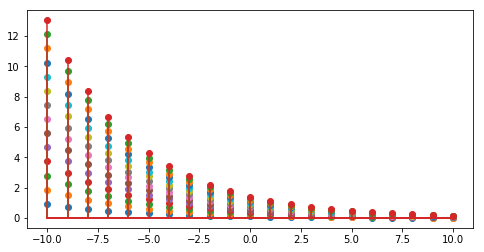

In [122]:
import numpy
import matplotlib.pyplot as plt

a = 0.8
n_all = np.arange( -10, 11 )

plt.figure( figsize = (8, 4) )

A = np.arange( 0.1, 1.5, 0.1 )
for i, A_cur in enumerate( A ):
    yh_cur = A_cur * np.power( a, n_all )
    plt.stem( n_all, yh_cur,
              markerfmt = 'C{0}o'.format( i % 10 ),
              linefmt = 'C{0}-'.format( i % 10 ) )

(Notice how each time point still has the ability to uniquely determine, by serving as an initial condition, the desired trajectory of $y_h$ \[the particular set of dots\]!)

**Talk about the general family of solutions, $y = y_h + y_p$**

Now, let's return to the scenario in which we have a nonzero input $x(n)$. Before we determine the full output of this system, let's determine a few of its properties, as these will help greatly in our pursuit.

(**I'm pretty sure the derivations below are wrong**)

First, let's note that the EMA system is, in fact, *linear*:

$$
\begin{eqnarray*}
    y_1(n) - a\,y_1(n-1) & = & x_1(n) \\
    y_2(n) - a\,y_2(n-1) & = & x_2(n) \\
    \therefore\,\alpha_1(y_1(n) - a\,y_1(n-1)) + \alpha_2(y_2(n) - a\,y_2(n-1) & = & \alpha_1\,x_1(n) + \alpha_2\,x_2(n) \\
    (\alpha_1\,y_1(n) + \alpha_2\,y_2(n)) - a\,(\alpha_1\,y_1(n-1) + \alpha_2\,y_2(n-1)) & = & "
\end{eqnarray*}
$$

Second, we also find that the EMA system is *translation-invariant*:

$$
\begin{eqnarray*}
    y(n) - a\,y(n-1) & = & x(n) \\
    \therefore\,y(n-k) - a\,y(n-k-1) & = & x(n-k) \\
    \textrm{Let } x'(n) = x(n-k) & , & y'(n) = y(n-k) \\
    \therefore\,y'(n) - a\,y'(n-1) & = & x'(n)
\end{eqnarray*}
$$

So, the EMA system is LTI! This gives us a good approach as to how to 

$\ldots$

**Talk about zero initial conditions and how this is necessary for LTI**

**Talk about zero initial conditions and how this is necessary for causality**

Now that we've established conditions for which our EMA system is LTI, we can leverage the tools we've built up for understanding LTI systems! For example, what is the *impulse response* of this system? Well, we can start by plugging in a unit impulse into the defining equation:

$$ h(n) - a\,h(n-1) = (1-a)\,\delta(n) $$

Under the zero initial conditions assumption (which is necessary for the system to be LTI), we note that the output $h$ must be $0$ at all times before the onset of the input $\delta(n)$ at $n = 0$; hence, at $n = 0$, we must have

$$ h(0) - a\,h(-1) = (1-a)\,\delta(0) \Rightarrow h(0) = 1-a $$

Aha! Now we can start to recurse: because the input "shuts off" after this first sample, the defining equation tells us that

$$ h(n) = a\,h(n-1) $$

for subsequent $n$; this gives us a sequence for $h$:

$$ 1-a, (1-a)\,a, (1-a)\,a^2, (1-a)\,a^3, \ldots, (1-a)\,a^n, \ldots $$

starting at sample $n = 0$. We can conveniently write this for all samples as

$$ h(n) = (1-a)\,a^n\,\theta(n) $$

Because the EMA system with zero initial conditions is LTI, we now know a **particular solution** of our defining equation for *any* input, as the output of an LTI system is simply the convolution of the input with the impulse response, which we've just determined:

$$ y_p(n) = (x \ast h)(n) $$

<a id="example_sma_ema"></a>
***

#### **Example**: Simple andn exponential moving average

Let's take a minute to examine the behavior of the EMA system $T_{\mathrm{EMA}(a)}$ compared to the simple moving average system $T_{\mathrm{MA}(N)}$. First, let's compare their impulse responses, using the common convention in finance to let [$a = 1 - \frac{2}{N+1}$](https://en.wikipedia.org/wiki/Moving_average#Relationship_between_SMA_and_EMA):

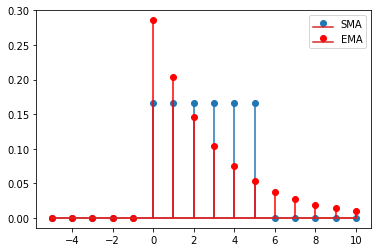

In [125]:
import numpy as np
import matplotlib.pyplot as plt

N = 6
a = 1. - 2. / (N + 1)

n_all = np.arange( -5, 11 )

h_sma = np.zeros( n_all.shape )
h_sma[(n_all >= 0) & (n_all < 6)] = 1. / N
h_ema = np.zeros( n_all.shape )
h_ema[n_all >= 0] = (1 - a) * np.power( a, n_all[n_all >= 0] )

plt.stem( n_all, h_sma, label = 'SMA' )
plt.stem( n_all, h_ema, markerfmt = 'ro', linefmt = 'r-', label = 'EMA' )
plt.legend()
plt.show()

Note a few differences immediately. The SMA has a **finite duration**; it is only nonzero for $N$ samples. On the other hand, the EMA has an **infinite duration**: the tail going off to the right is nonzero for all $n > 0$, and hence, the EMA incorporates information from *all past sampmles*, even if it is only to a very small degree. Note also that the EMA places greater weight on "nearby" (closer to $n = 0$) samples than the SMA. However, importantly, both the SMA and the EMA have impulse responses that sum to $1$. First, note that the SMA system's impulse response is given by plugging an impulse $\delta$ into the SMA defining equation above:

$$ h_{\mathrm{MA}(N)} = \frac{1}{N}\,\sum_{k=0}^{N-1} \delta(n-k) $$

We can compactly write this using the unit step function $\theta$ as

$$ h_{\mathrm{MA}(N)} = \frac{1}{N}\,\theta(n)\,\theta(N - 1 - n) $$

where we note that $\theta(N-1-n)$ is $1$ whenever $n \leq N-1$ and $0$ elsewhere. Now, the sums of the impulse responses for these average systems are given by:
 
$$
\begin{eqnarray*}
    \sum_{k=-\infty}^\infty h_{\mathrm{MA}(N)}(k) & = & \sum_{k=-\infty}^\infty \frac{1}{N}\,\theta(k)\,\theta(N-1-k) \\
     & = & \frac{1}{N}\,\sum_{k=0}^{N-1} 1 \\
     & = & \frac{1}{N}\,N \\
     & = & 1 \\
    \sum_{k=-\infty}^\infty h_{\mathrm{EMA}(a)}(k) & = & \sum_{k=-\infty}^\infty (1-a)\,a^k\,\theta(k) \\
     & = & (1-a) \sum_{k=0}^\infty a^k \\
     & = & (1-a)\,\frac{1}{1-a}\quad(\ast) \\
     & = & 1
\end{eqnarray*}
$$

(Note that (\*) follows from the [geometric series formula](https://en.wikipedia.org/wiki/Geometric_series#Formula).)

Intuitively, the fact that the two impulse responses sum to $1$ indicates that both systems do not *scale* the input; this is a very valuable property for a system that is doing *averaging*, as the output should ideally be in the same data units as the input! We can see this firsthand by applying both systems to some real-world data:

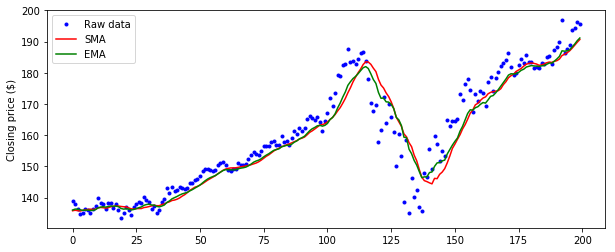

In [130]:
import yfinance
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt

cur_ticker = 'MSFT'

msft = yfinance.Ticker( cur_ticker )
msft_history = msft.history( period = '1y' )

msft_date = msft_history.index
msft_close = msft_history.loc[:, 'Close']

# Compute the simple moving average
ma_N = 12
msft_close_ma = np.zeros( msft_close.shape )
for n in range( msft_close.shape[0] ):
    cur_sum = 0.
    for i in range( 0, ma_N ):
        cur_idx = n - i
        if cur_idx < 0:
            # We assume that anything we don't have a data point for is a zero
            # That is, our signal is assumed to be *zero-padded*
            cur_input = 0.
        else:
            cur_input = msft_close[cur_idx]
        cur_sum += cur_input
    msft_close_ma[n] = (1. / ma_N) * cur_sum

# Compute the exponential moving average
ema_a = 1 - (2. / (ma_N + 1.))
msft_close_ema = np.zeros( msft_close.shape )
for n in range( msft_close.shape[0] ):
    # Enforce zero initial conditions
    y_prev = 0. if n == 0 else msft_close_ema[n-1]
    # Use the recursion equation
    msft_close_ema[n] = ema_a * y_prev + (1 - ema_a) * msft_close[n]

n_lookback = 200
msft_idx = np.arange( n_lookback )

plt.figure( figsize = (10, 4) )
plt.plot( msft_idx, msft_close[-n_lookback:], 'b.', label = 'Raw data' )
plt.plot( msft_idx, msft_close_ma[-n_lookback:], 'r-', label = 'SMA' )
plt.plot( msft_idx, msft_close_ema[-n_lookback:], 'g-', label = 'EMA' )
plt.ylabel( 'Closing price ($)' )
plt.legend()
plt.show()

Both averages perform very similarly under real-world conditions; however, it's worth noting that under certain circumstances (for example, strong reversals) the EMA will "hug" the data a little more than the SMA. Why is this? Well, it's precisely because of the **impulse response**! Because the EMA has a bit more weight on samples near $n = 0$, the output of the EMA system is driven a bit more by these *more recent* samples (because, as we recall from the video demonstration above, the impulse response can be thought of as a *local weighting*, with $n=0$ of the impulse response corresponding to the current *output sample* of the system).

<a id="rest_initial"></a>
***

### Rest initial conditions

Now, as we noted above, the complete family of solutions of this defining equation is given by

$$ y(n) = y_p(n) + y_h(n) $$

where $y_p$ is the particular solution we've just determined above, and $y_h$ is one of the family of homogeneous solutions, which we determined earlier. Hence, the general form of a solution to this defining equation is given by

$$ y(n) = (x \ast h)(n) + A\,a^n $$

where $A$ is determined based on the desired initial conditions for $y$. Note that, if $A$ is nonzero, then $y(n)$ extends infinitely into the past for any input $x$, even, for example, $\theta(n)$, which is $0$ for $n < 0$; hence, if we let $A$ be nonzero (*i.e.*, do not have zero initial conditions), then our system will not be causal. Similarly, nonzero values of $A$ will also lead to violations of linearity; for example, for inputs $x_1$ and $x_2$ we have outputs

$$
\begin{eqnarray*}
    y_1(n) & = & (x_1 \ast h)(n) + A\,a^n \\
    y_2(n) & = & (x_2 \ast h)(n) + A\,a^n
\end{eqnarray*}
$$

The output to the *sum* of these two inputs is given by

$$
\begin{eqnarray*}
    y_s(n) & = & ((x_1 + x_2) \ast h)(n) + A\,a^n \\
     & = & (x_1 \ast h)(n) + (x_2 \ast h)(n) + A\,a^n
\end{eqnarray*}
$$

where we have used the distributive property of convolution. However, this is **not** equal to the sum of the two individual outputs:

$$ y_1(n) + y_2(n) = (x_1 \ast h)(n) + (x_2 \ast h)(n) + 2\,A\,a^n $$

So, while our **defining equation** allows a family of solutions with different initial conditions, the only choice of conditions which leads to a system that is *causal* and *LTI* is the **initially at rest** condition,

$$ x(n) = 0,\, n < n_0\quad\Rightarrow\quad y(n) = 0,\, n < n_0 $$

<a id="diff_eq_general_case"></a>
***

### The general case

Above, when discussing translation-invariance, we made use of the *delay operators* $D_a$ for some lag $a$ (discrete or continuous); specifically, we noted that a translation-invariant system is one that *commutes* with all of the delay operators. Interestingly, if we examine the defining equations of the simple moving average system $T_{\mathrm{MA}(N)}$ and the exponential moving aveerage system $T_{\mathrm{EMA}(a)}$, both of them can be rephrased entirely in terms of delay operators. For example, the SMA system is given by

$$ y(n) = \frac{1}{N}\,\sum_{k=0}^{N-1} x(n-k) $$

which, rephrased in terms of delays, is equivalent to

$$ y = \sum_{k=0}^{N-1}\frac{1}{N}\,D_k(x) $$

Since each higher-order delay operator $D_k$ is really just a composition of unit delays $D_1$

$$ D_k = \underbrace{D_1 \circ D_1 \circ \ldots \circ D_1}_{k\textrm{ times}} = D_1^k $$

we can treat the entire equation as a "polynomial" in the unit delay $D_1$; that is,

$$ y = \sum_{k=0}^{N-1} \frac{1}{N}\,D_1^k\,x = Q(D_1)\,x $$

where we use the notational convenience $D_1\,x = D_1(x)$, and where

$$ Q(D_1) = \underbrace{\frac{1}{N}}_{D_1^0 = 1} + \frac{1}{N}\,D_1 + \frac{1}{N}\,D_1^2 + \ldots + \frac{1}{N}\,D_1^{N-1} $$

is our polynomial in the unit delay.

In the case of the EMA above, we also note that the defining equation can be entirely written in terms of delay operators:

$$ y(n) - a\,y(n-1) = x(n) \quad \Rightarrow \quad (1 - a\,D_1)\,y = x $$

We note that, similar to above, $y$ is acted on by a *polynomial* $P$ in the unit delay $D_1$, with

$$ P(D_1) = 1 - a\,D_1 $$

Each of these examples is at one end of the spectrum: the SMA has higher-order terms only on the $x$ side of the equation, and the EMA has higher-order terms only on the $y$ side. In general, there is a whole class of systems that can be deescribed by equations with polynomials in unit delay operators; that is, for which the defining equation is

$$ P(D_1)\,y = Q(D_1)\,x $$

These are calleld **linear constant-coefficient difference equations**, and they play a very important role in signal processing, as we will learn in the next section.

As we showed in our example of the exponential moving average above, it is often interesting to consider the case where $x = 0$; that is, when

$$ P(D_1)\,y = 0 $$

This is called the **homogeneous equation**, and as above, solutions to it are important as they govern the dynamics of the system *in the absence of input*. In the case of the EMA system, we made a guess of a solution in the form of an exponential, $y_h(n) = A\,z^n$; this holds true in the general case too! Let the general $N$th order polynomial $P$ be given by

$$ P(D_1) = a_0 + a_1\,D_1 + a_2\,D_1^2 + \ldots + a_N\,D_1^N = \sum_{k=0}^N a_k D_1^k $$

Then, plugging our guess of a solution, we have

$$
\begin{eqnarray*}
    P(D_1)\,A\,z^n & = & 0 \\
    A\left( \sum_{k=0}^N a_k\,D_1^k\,z^n \right) & = & 0 \\
    A\left( \sum_{k=0}^N a_k\,z^{n-k} \right) & = & 0 \\
    A\,z^n\,\sum_{k=0}^N a_k\,z^{-k} & = & 0 \\
    \sum_{k=0}^N a_k\,z^{-k} & = & 0
\end{eqnarray*}
$$

This last form is known as the **characteristic equation**, and is a polynomial of degree $N$ in $z^{-1}$. Using the [fundamental theorem of algebra](https://en.wikipedia.org/wiki/Fundamental_theorem_of_algebra), we can solve this polynomial to get $N$ complex-valued roots (counted with multiplicity), which we'll denote $z_1,z_2,\ldots,z_N$. Each one of these roots is a valid choice to use as a value of $z$ in our "guessed" solution $A\,z^n$, meaning that each $A\,z_k^n$ is a valid solution of the homogeneous equation; however, we have even more options to choose from!

Suppose that $y_1$ and $y_2$ are both solutions of our homogeneous equation,

$$
\begin{eqnarray*}
    P(D_1)\,y_1 & = & 0 \\
    P(D_1)\,y_2 & = & 0
\end{eqnarray*}
$$

Now, suppose we have a *new* function $y_h = c_1\,y_1 + c_2\,y_2$ which is a *linear combination* of our known homogeneous solutions. Then, we note that

$$
\begin{eqnarray*}
    P(D_1)\,y_h & = & P(D_1)\,(c_1\,y_1 + c_2\,y_2) \\
     & = & c_1\,P(D_1)\,y_1 + c_2\,P(D_1)\,y_2 \\
     & = & c_1\,0 + c_2\,0 \\
     & = & 0
\end{eqnarray*}
$$

Hence, any linear combination of solutions to the homogeneous equation *is also* itself a solution to the homogeneous equation!

Since we know that $z_1^n, z_2^n,\ldots,z_N^n$ are all solutions of the homogeneous equation, this means that so is the linear combination

$$ y_h(n) = c_1\,z_1^n + c_2\,z_2^n + \ldots + c_N\,z_N^n $$

for arbitrary constants $c_1,\ldots,c_N$. This is the *family* of **general homogeneous solutions**, as it can be [proved]() that all solutions of the homogeneous equation are of this form. This is a very important point that will come up again in our study of these kinds of systems, however: the **roots** of the characteristic equation above are precisely the exponential bases of the homogeneous solution. This means that the characteristic equation of the system determines the *intrinsic dynamics* of the system with *zero input*!

<a id="example_intrinsic_dynamics"></a>
***

#### **Example**: Intrinsic dynamics

Consider the system defined by the difference equation

$$ y(n) - 1.2\,y(n-1) + 0.32\,y(n-2) = \frac{1}{3}\,x(n) + \frac{1}{3}\,x(n-1) + \frac{1}{3}\,x(n-2) $$

The characteristic equation of this system is given by

$$ 1 - 1.2\,z^{-1} + 0.32\,z^{-2} = z^{-2}\,(z^2 - 1.2\,z + 0.32) = z^{-2}\,(z-0.4)\,(z-0.8) $$

Hence, our roots are $z_1 = 0.4$ and $z_2 = 0.8$. This means that our general homogeneous solution for this system is given by

$$ y_h(n) = c_1\,(0.4)^n + c_2\,(0.8)^n $$

for arbitrary constants $c_1$ and $c_2$. Let's see what one of these solutions looks like:

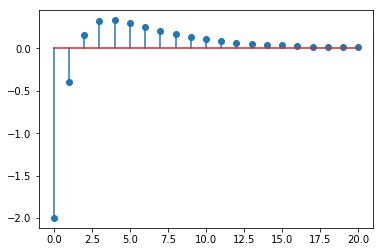

In [137]:
import numpy as np
import matplotlib.pyplot as plt

c1 = -3.0
c2 = 1.0

n_all = np.arange( 0, 21 )
y_h = c1 * np.power( 0.4, n_all ) + c2 * np.power( 0.8, n_all )

plt.stem( n_all, y_h )
plt.show()

Notice how as the signal progresses to the right (positive $n$), we once again see our pattern of exponential decay. Indeed, we can even tell something about the rate of this decay based on the roots of the characteristic equation. As was mentioned above, the general homogeneous solution for this system is given by

$$ y_h(n) = c_1\,(0.4)^n + c_2\,(0.8)^n $$

We note, however, ,that for sufficiently high $n > n_0$, there is a coefficient $c_2'$ such that

$$ c_2'\,|0.8|^n \geq \left|c_1\,(0.4)^n + c_2\,(0.8)^n\right| = |y_h(n)| $$

To see this, let $c_2' = |c_1| + |c_2|$; noting that

$$ |(0.8)^n| = |0.8|^n > |0.4|^n = |(0.4)^n| $$

for $n > 0$, we see that

$$
\begin{eqnarray*}
    |0.8|^n & \geq & |0.4|^n \\
    |c_1||0.8|^n & \geq & |c_1||0.4|^n \\
    |c_1||0.8|^n + |c_2||0.8|^n & \geq & |c_1||0.4|^n + |c_2||0.8|^n \geq \left|c_1\,(0.4)^n + c_2\,(0.8)^n\right| \quad (\ast) \\
    (|c_1| + |c_2|)|0.8|^n & \geq & \left|c_1\,(0.4)^n + c_2\,(0.8)^n\right| \\
    c_2'\,|0.8|^n & \geq & |y_h(n)|
\end{eqnarray*}
$$

where the second inequality in (\*) follows from the [triangle inequality](https://en.wikipedia.org/wiki/Absolute_value#Real_numbers).

What this whole pursuit—trying to bound our solution by a simple exponential function, $c_2'\,|0.8|^n$—is saying is that the *long-term* behavior of our system is dictated by the **largest root** of the characteristic equation (in this case, $0.8$); while the other roots may dictate *transient* behavior of the solutions (as shown in the first few rising samples of the example solution above), for larger $n$ the exponential behavior of these solutions becomes dominated by the term with the *largest exponent base*.

Let's see this in action for the solution we just examined:

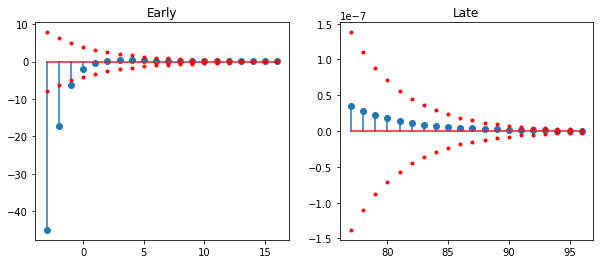

In [147]:
import numpy as np
import matplotlib.pyplot as plt

c1 = -3.0
c2 = 1.0
c2_prime = np.abs( c1 ) + np.abs( c2 )

n_all = np.arange( -3, 100 )
y_h = c1 * np.power( 0.4, n_all ) + c2 * np.power( 0.8, n_all )
y_h_bound = c2_prime * np.power( 0.8, n_all )

fig, axs = plt.subplots( 1, 2, figsize = (10, 4) )

axs[0].stem( n_all[0:20], y_h[0:20] )
axs[0].plot( n_all[0:20], y_h_bound[0:20], 'r.' )
axs[0].plot( n_all[0:20], -y_h_bound[0:20], 'r.' )
axs[0].set_title( 'Early' )

axs[1].stem( n_all[80:100], y_h[80:100] )
axs[1].plot( n_all[80:100], y_h_bound[80:100], 'r.' )
axs[1].plot( n_all[80:100], -y_h_bound[80:100], 'r.' )
axs[1].set_title( 'Late' )

plt.show()

Notice how this behavior is violated as we go to the *left*; as we will see in the next section, signals may have vastly different behavior going in one direction versus the other! This is why it is important to note that our constraint holds for *large $n$*—that is, for $n > n_0$ for some constant $n_0$.

***

Equipped with the general homogeneous solution, we now move to attempting to solve the *general* problem

$$ P(D_1)\,y = Q(D_1)\,x $$

for nonzero $x$. Numerically, the equation itself provides a convenient algorithm for computing the output $y$: recall that we can expand the polynomials $P$ (of order $N$) and $Q$ (of order $M$) to find that

$$
\begin{eqnarray*}
    \sum_{k=0}^N a_k\,D_1^k\,y & = & \sum_{k=0}^M b_k\,D_1^k\,x \\
    a_0\,y(n) + \sum_{k=1}^N a_k\,y(n-k) & = & \sum_{k=0}^M b_k\,x(n-k) \\
    y(n) & = & \frac{1}{a_0}\,\left( \sum_{k=0}^M b_k\,x(n-k) - \sum_{k=1}^N a_k\,y(n-k) \right)
\end{eqnarray*}
$$

As long as we have $M$ previous values for $x$ and $N$ previous values for $y$ available, we can actually use this to compute $y(n)$ for a given $n$! However, this raises the point which we saw earlier with the exponential moving average system, namely that, to start the process off, we need **initial conditions**; that is, we need sufficient starting values of $y$ to be able to run this equation once. Once we have those starting values, we can use the new computed values of $y$ as the new "initial" conditions for the next sample, and repeat the process *ad nauseum*; however, without those $N$ values of $y$ we can't even get started!

Now, should we be able to find a **particular solution** $y_p$ to the general problem $P(D_1)\,y = Q(D_1)\,x$, we automatically are given an entire *family* of admissible solutions. Above, we saw that any homogeneous solution $y_h$ satisfies

$$ P(D_1)\,y_h = 0 $$

Hence, we must also have that, given a particular solution $y_p$ and a homogeneous solution $y_h$,

$$
\begin{eqnarray*}
    P(D_1)\,(y_p + y_h) & = & P(D_1)\,y_p + P(D_1)\,y_h \\
     & = & Q(D_1)\,x + 0 \\
     & = & Q(D_1)\,x
\end{eqnarray*}
$$

Hence the sum $y_p + y_h$ must *also* be a solution to the general equation!

As we saw in the case of the exponential moving average system, the particular choice of $y_h$ depends on the selection of the **initial conditions** of the system; indeed, it is an important point that a difference equation of the type we have been working with is **not** a complete specification of a system *unless* the initial conditions are specified; otherwise, the solution is not uniquely defined!

**Show that causal, LTI $\Rightarrow$ zero IC**